# Анализ визитов на сайт компании D***s. 
## * Выявление закономерностей в рекламной аудитории. 
## * Поиск признаков скликивания рекламной кампании в Яндекс.Директе.

1. [**Подготовка данных к анализу.**](#100101)
*******************************
2. [**Исследовательский анализ данных.**](#100102)
    * [2.1.Общие данные таблицы (все данные).](#102100)
    * [2.2.Источники трафика (все данные).](#102101)
    * [2.3.Страны (все данные).](#102102)
    * [2.4.Города (все данные).](#102103)
    * [2.5.Посетители приходящие по рекламе Яндекс.Директ.](#102104)
    * [2.6.Визиты во времени.](#102105)
    * [2.7.Минуты на сайте во времени.](#102106)
*******************************
3. [**Исследование отказов.**](#100103)
    * [3.1.Общий обзор. ](#103100)
    * [3.2.Отказы и неотказы во времени.](#103101)
    * [3.3.Количество секунд разделенных по источникам трафика среди отказов и неотказов. Пропущенные нулевые визиты во времени и по источникам трафика.](#103102)
    * [3.4.Количество секунд по устройствам и датам среди отказов и неотказов.](#103103)
    * [3.5.Количество визитов по устройствам и временным зонам среди отказов и неотказов.](#103104)
    * [3.6.Количество визитов разделенное по операционным системам и минутам проведенным на сайте среди отказов и неотказов.](#103105)
    * [3.7.Среднее количество секунд просмотра по браузерам среди неотказов с 2018 г.](#103106)
    * [3.8.Среднее количество секунд просмотра по операционным системам среди неотказов с 2018 г.](#103107)
    * [3.9.Среднее количество секунд просмотра по поисковым системам среди неотказов с 2018 г.](#103108)
    * [3.10.Среднее количество секунд просмотра по источникам трафика среди неотказов с 2018 г.](#103109)
    * [3.11.Среднее количество секунд просмотра по типам соединения среди неотказов с 2018 г.](#103110)
    * [3.12.Среднее количество секунд на сайте по устройствам среди неотказов с 2018 г.](#103111)
    
*******************************
4. [**Исследование рекламных и нерекламных визитов раздельно.**](#100104)
    * [4.1.Общие данные по рекламным и нерекламным визитам. ](#104100)
    * [4.2.Система распознавания отказов в Яндекс.Директе.](#104101)
    * [4.3.Сезонность.](#104102)
    * [4.4.Распределение отказов во времени, в зависимости от типа визитов.](#104103)
    * [4.5.Типы  соединения в зависимости от типа визитов.](#104104)
    * [4.6.Типы  соединения  по датам, в зависимости от типа визитов.](#104105)    
    * [4.7.Типы поисковых систем по типам визитов.](#104106)  
    * [4.8.Типы поисковых систем по типам визитов (подробно).](#104107)  
    * [4.9.Типы  операционных систем по типам визитов.](#104108)
    * [4.10.Браузеры по типам визитов и по отказам.](#104109)
    * [4.11.Виды устройств по типам визитов.](#104110)
*******************************
5. [**Исследование для поиска мошеннических действий.**](#100105)
    * [5.1.Скопления IP по времени, среди отказов по типам визитов.](#105100)
    * [5.2.Скопления IP из США по типам визитов и отказам..](#105101)   
*************************************
6. [**Исследование подозрительных IP.**](#100106)
    * [6.1.IP 66.249.89.xxx.](#106100)
    * [6.2.IP 72.14.199.xxx.](#106101)
    * [6.3.IP 23.100.232.xxx.](#106102)
    * [6.4.IP 83.220.238.xxx.](#106103) 
*******************************
7. [**Матрицы корреляции.**](#100107)
    * [7.1.Общая матрица корреляции признаков. ](#107100)
    * [7.2.Матрица корреляции признаков разделенных по оттоку. ](#107101)
    * [7.3.Матрица корреляции признаков разделенных по рекламе. ](#107102)
    * [7.4.Матрица корреляции признаков разделенных по устройствам. ](#107103)
    * [7.5.Матрица корреляции признаков разделенных по устройствам. ](#107104)
******************************
8. [**Гипотезы.**](#100108)
    * [8.1.Гипотеза. ](#108100)
    * [8.2.Гипотеза. ](#108101)
******************************
9. [**Выводы и базовые рекомендации.**](#100109)

Данные о сайте добудем с помощью готового скрипта, предварительно изменив его под свои нужды. Личная благодарность Роману Боландеу https://github.com/bolandeu/scripts/tree/master/antalyzer_py за готовый скрипт.

In [61]:
import pandas as pd

import matplotlib.pyplot as plt
from pandas.plotting import register_matplotlib_converters
import plotly.express as px
import plotly.graph_objs as go

import math
import numpy as np
import seaborn as sns
from scipy import stats as st
import re

pd.options.mode.chained_assignment = None
pd.options.display.max_colwidth = 100
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500) 
pd.set_option('display.width', 1000)

#from sklearn.decomposition import PCA
#import ml_metrics, string, re, pylab as pl
#from sklearn.metrics import roc_curve
#from sklearn import preprocessing
#from sklearn.pipeline import Pipeline

from plotly import graph_objects as go
from pandas.plotting import scatter_matrix

## 1. Подготовка данных к анализу. <a id='100101'></a>

* *Прочитаем таблицу и посмотрим на параметры*

In [62]:
path1 = 'visits_6700084_20131007_20190215.xlsx'
v = pd.read_excel(path1, delimiter='\t')

In [63]:
v.sample(5)

,Идентификатор визита,Дата и время визита,Страница входа,Глубина просмотра (детально),Время на сайте (детально),Отказность,IP адрес,Страна (ISO),Город (английское название),Идентификатор пользователя на сайте,Тип соединения,Источник трафика,Рекламная система,Переход с сайтов,Поисковая система,Поисковая система (детально),Реферер,Название группы объявлений,Название объявления Яндекс.Директа,Условие показа объявления,Тип площадки,Площадка,Openstat Ad,Часовой пояс на компьютере посетителя,"Тип устройства. Возможные значения: 1 — десктоп, 2 — мобильные телефоны, 3 — планшеты, 4 — TV",Производитель устройства,Модель устройства,Группа операционных систем,Операционная система (детально),Браузер,Движок браузера,Наличие Cookie,Соотношение сторон,Глубина цвета,Ориентация экрана,Логическая ширина,Логическая высота,Физическая ширина,Физическая высота
113286,6314800959633165727,2019-10-25 22:24:13,http://dopservis.ru/uslugi/pandora/pandora-dx-6x/,1,0,1,37.204.95.xxx,Russia,Moscow,1572031453259456876,wi_fi,ad,ya_direct,yabs.yandex.ru,yandex,yandex_mobile_app,NaN,Группа №382155685,Сигнализация с автозапуском!,Установка автосигнализации с автозапуском -!своими -aligator -aps -pantera -sher -stalker -tomah...,Search,yandex.ru,4.435577e+08,180,2,samsung,SM-A705FN,android,android_pie90,yandexsearch,WebKit,1,9,24,1,412,915,1082,2402
75515,7308945179917167278,2016-12-07 19:50:13,http://dopservis.ru/uslugi/pandora/pandora-dx-50/,1,0,1,77.37.181.xxx,Russia,Moscow,1481129414604368843,NaN,ad,ya_direct,yabs.yandex.ru,yandex,yandex_search,NaN,Новая группа объявлений,Горячая цена на #Pandora DX 50#!,Pandora DX 50 -l,Search,yandex.ru,1.575372e+09,180,1,NaN,NaN,windows,windows_7_2008server,chrome,WebKit,1,37,24,2,1366,768,1366,768
50824,5913479168132613995,2015-10-01 20:28:20,http://dopservis.ru/index.php/uslugi/diagnostika,1,12,0,90.154.83.xxx,Russia,NaN,0,NaN,direct,ya_undefined,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,180,1,NaN,NaN,windows,windows_xp,yandex_browser,WebKit,1,26,24,2,1280,1024,1280,1024
45929,5887314505703280760,2015-07-19 22:04:02,http://dopservis.ru/,1,0,1,176.195.146.xxx,Russia,Moscow,0,NaN,direct,ya_undefined,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,180,1,NaN,NaN,windows,windows_7_2008server,opera,Presto,1,26,24,2,1280,1024,1280,1024
45738,5886156509547175623,2015-07-16 15:32:09,NaN,1,10,0,213.87.136.xxx,Russia,Moscow,0,NaN,direct,ya_undefined,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,180,2,lenovo,$1,android,android_jelly_bean42,android_browser,WebKit,1,11,32,1,540,960,540,960


Переименуем заголовки для удобства анализа (для расшифровки используем данные из метрики https://yandex.ru/dev/metrika/doc/api2/logs/fields/visits-docpage/ )

In [64]:
v.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118336 entries, 0 to 118335
Data columns (total 39 columns):
 #   Column                                                                                         Non-Null Count   Dtype  
---  ------                                                                                         --------------   -----  
 0   Идентификатор визита                                                                           118336 non-null  uint64 
 1   Дата и время визита                                                                            118336 non-null  object 
 2   Страница входа                                                                                 77990 non-null   object 
 3   Глубина просмотра (детально)                                                                   118336 non-null  int64  
 4   Время на сайте (детально)                                                                      118336 non-null  int64  
 5   Отказност

In [65]:
#v.columns
new_name = ('visitID', 'dateTime', 'URL', 'pageViews', 'visitDuration', 'bounce', 'IP', 'Country', 
            'City', 'clientID', 'networkType', 'TrafficSource', 'AdvEngine', 'ReferalSource', 'EngineRoot', 
            'SearchEngine', 'referer', 'ClickBannGroup', 'DirectClickBann', 'DirectPhraseOrCond', 'DirectPlType', 
            'DirectType', 'OpenstatAd', 'clientTimeZone', 'deviceCat', 'mobilePhone', 'mobileModel', 'operatingSystemRoot', 
            'operatingSystem', 'browser', 'browserEngine', 'Cookie', 'screenFormat', 'screenColor', 'screenOrient', 
            'screenWidth', 'screenHeight', 'physScreenWidth', 'physScreenHeight')

v.columns = (new_name)
#v.head()

In [66]:
#присвоим тип datetime столбцу даты и времени:
v['dateTime'] = (pd.to_datetime(v['dateTime']))

#добавим дополнительно столбws даты, дня недели, и времени:
v['date'] = v['dateTime'].dt.strftime('%Y-%m')
v['day'] = v['dateTime'].dt.weekday
v['day'] = v['day'].astype(object)
v['time'] = v['dateTime'].dt.strftime('%H-%M')

In [67]:
#посмотрим на пустые ячейки:
v.isnull().sum()

visitID                     0
dateTime                    0
URL                     40346
pageViews                   0
visitDuration               0
bounce                      0
IP                          0
Country                   143
City                    12668
clientID                    0
networkType            105007
TrafficSource               0
AdvEngine                   0
ReferalSource           39348
EngineRoot              50773
SearchEngine            50773
referer                115114
ClickBannGroup          69352
DirectClickBann             0
DirectPhraseOrCond      68614
DirectPlType            68614
DirectType              68614
OpenstatAd              54046
clientTimeZone              0
deviceCat                   0
mobilePhone             82693
mobileModel             82742
operatingSystemRoot      4543
operatingSystem          4543
browser                  4612
browserEngine           23478
Cookie                      0
screenFormat                0
screenColo

Много пропущенных значений в networkType, referer, EngineRoot, SearchEngine, ClickBannGroup, DirectPhraseOrCond, DirectPlType, DirectType, OpenstatAd, mobilePhone, mobileModel - это связано и со структурой данных и с их спецификой. Пока заменим отсутствующие значения на n и 0, т.к. нам понадобится исследовать и отсутствующие.

In [68]:
#заполним пустые ячейки и изменим тип некотрых столбцов:
v['URL'] = v['URL'].fillna('n')
v['Country'] = v['Country'].fillna('n')
v['City'] = v['City'].fillna('n')
v['networkType'] = v['networkType'].fillna('none')
v['ReferalSource'] = v['ReferalSource'].fillna('n')
v['EngineRoot'] = v['EngineRoot'].fillna('n')
v['SearchEngine'] = v['SearchEngine'].fillna('n')
v['referer'] = v['referer'].fillna('n')
v['ClickBannGroup'] = v['ClickBannGroup'].fillna('n')
v['DirectPhraseOrCond'] = v['DirectPhraseOrCond'].fillna('n')
v['DirectPlType'] = v['DirectPlType'].fillna('n')
v['DirectType'] = v['DirectType'].fillna('n')
v['OpenstatAd'] = v['OpenstatAd'].fillna(0)
v['OpenstatAd'] = v['OpenstatAd'].astype(int)
v['mobilePhone'] = v['mobilePhone'].fillna('n')
v['mobileModel'] = v['mobileModel'].fillna('n')
v['operatingSystemRoot'] = v['operatingSystemRoot'].fillna('n')
v['operatingSystem'] = v['operatingSystem'].fillna('n')
v['browser'] = v['browser'].fillna('n')
v['browserEngine'] = v['browserEngine'].fillna('n')
v['deviceCat'] = v['deviceCat'].astype(object)
v['screenFormat'] = v['screenFormat'].astype(object)
v['screenColor'] = v['screenColor'].astype(object)
v['screenOrient'] = v['screenOrient'].astype(object)
v['screenWidth'] = v['screenWidth'].astype(object)
v['screenHeight'] = v['screenHeight'].astype(object)
v['physScreenWidth'] = v['physScreenWidth'].astype(object)
v['physScreenHeight'] = v['physScreenHeight'].astype(object)

Посмотрим на некоторые параметры еще раз.

In [69]:
#v.info()

In [70]:
#v.isnull().sum()
v.sample(7)

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time
15850,5739734166085355404,2014-05-28 22:38:06,http://dopservis.ru/index.php/uslugi/mekhanicheskie-blokiratory/zamki-kpp-akpp,1,15,0,109.252.2.xxx,Russia,Moscow,0,none,ad,ya_direct,yandex.ru,yandex,yandex_mobile,n,n,Замки #АКПП MUL-T-LOCK#!,МУЛЬТИЛОК АКПП -отзыв -цилиндр,Search,yandex.ru,155625197,570,2,lenovo,Lenovo IdeaPhone,android,google_android,yandex_browser,n,1,11,32,1,360,640,0,0,2014-05,2,22-38
21550,5776030534375120586,2014-09-08 12:08:24,http://dopservis.ru/,8,303,0,195.208.58.xxx,Russia,Moscow,0,none,referral,ya_undefined,alarmtrade.ru,n,n,n,n,0,n,n,n,0,240,1,n,n,windows,windows_7_2008server,firefox,n,1,37,24,2,1600,900,0,0,2014-09,0,12-08
42414,5866213280125470581,2015-05-21 07:02:56,n,3,50,0,92.243.181.xxx,Russia,n,0,none,direct,ya_undefined,n,n,n,n,n,0,n,n,n,443557742,240,1,n,n,windows,windows_xp,chrome,WebKit,1,26,24,2,1280,1024,1280,1024,2015-05,3,07-02
70481,4579111194692421499,2016-08-09 07:12:02,n,1,0,1,194.190.21.xxx,Russia,Moscow,147071592191258417,none,ad,ya_undefined,n,n,n,n,n,0,n,n,n,443557725,180,1,n,n,windows,windows_7_2008server,msie,Trident,1,26,24,2,1280,1024,1280,1024,2016-08,1,07-12
78035,312203079187433339,2017-02-02 21:49:20,n,1,15,0,77.37.208.xxx,Russia,Moscow,1486061360125883773,wi_fi,ad,ya_direct,n,n,n,n,Группа №382155685 (копия),Сезонные спеццены на автозапуск!,Авто запуск дешево,Context,com.yandex.browser,-2147483648,180,3,samsung,SM-T531,android,android_lollipop5,yandex_browser,WebKit,1,33,32,2,1280,800,1280,800,2017-02,3,21-49
116096,7599841506979680024,2019-12-21 16:04:54,http://dopservis.ru/news/test-na-dalnost-populyarnyh-avtosignalizatsij/,1,19,0,2.92.49.xxx,Russia,Saratov,1576933494217242668,wi_fi,organic,ya_undefined,yandex.ru,yandex,yandex_mobile,https://yandex.ru/,n,0,n,n,n,0,180,2,google,Nexus 5,android,android_jelly_bean42,chromemobile,WebKit,1,10,24,1,384,744,768,1488,2019-12,5,16-04
88333,6290392646650953854,2017-10-24 20:32:23,n,10,357,0,62.78.56.xxx,Russia,Lytkarino,1508862206575577581,none,internal,ya_undefined,dopservis.ru,n,n,n,n,0,n,n,n,0,180,1,n,n,windows,windows_7_2008server,chrome,WebKit,1,26,24,2,1280,1024,1280,1024,2017-10,1,20-32


Узнаем сколько у нас было визитов и посетителей за все время, а так же среднее количество визитов на одного посетителя.

In [71]:
page = v['pageViews'].value_counts().sum()
print("Количество просмотренных страниц из колонки pageViews -", page)

Количество просмотренных страниц из колонки pageViews - 118336


In [72]:
vis = v['visitID'].value_counts().count()
print("Количество визитов всего -", vis)

Количество визитов всего - 118336


Количество визитов и количество просмотренных страниц совпадает.

In [73]:
print('Количество пользователей за все время наблюдений:', len(v['clientID'].unique()))
print('В среднем событий на каждого пользователя: {:.1f}'.format(v.groupby('clientID')['visitID'].count().mean()))

Количество пользователей за все время наблюдений: 45134
В среднем событий на каждого пользователя: 2.6


In [74]:
#добавим столбец с часами, чтобы тратить меньше времени на построение графиков:
def times(time):
    if time <= '00-59':
        return 'c 24 до 1 часа'
    elif time <= '01-59':
        return 'с 1 часа до 2'
    elif time <= '02-59':
        return 'с 2-х до 3-х'
    elif time <= '03-59':
        return 'с 3-х до 4-х'
    elif time <= '04-59':
        return 'с 4-х до 5'
    elif time <= '05-59':
        return 'с 5 до 6'
    elif time <= '06-59':
        return 'с 6 до 7'
    elif time <= '07-59':
        return 'с 7 до 8'
    elif time <= '08-59':
        return 'с 8 до 9'
    elif time <= '09-59':
        return 'с 9 до 10'
    elif time <= '10-59':
        return 'с 10 до 11'
    elif time <= '11-59':
        return 'с 11 до 12'
    elif time <= '12-59':
        return 'с 12 до 13'
    elif time <= '13-59':
        return 'с 13 до 14'
    elif time <= '14-59':
        return 'с 14 до 15'
    elif time <= '15-59':
        return 'с 15 до 16'
    elif time <= '16-59':
        return 'с 16 до 17' 
    elif time <= '17-59':
        return 'с 17 до 18'
    elif time <= '18-59':
        return 'с 18 до 19'
    elif time <= '19-59':
        return 'с 19 до 20'
    elif time <= '20-59':
        return 'с 20 до 21'
    elif time <= '21-59':
        return 'с 21 до 22'
    elif time <= '22-59':
        return 'с 22 до 23' 
    elif time <= '23-59':
        return 'с 23 до 24'

v['t'] = v['time'].apply(times)
#v.head()

## 2. Исследовательский анализ данных. <a id='100102'></a>

Посмотрим на общие признаки представляющие интерес:

### 2.1. Общие данные таблицы (все данные). <a id='102100'></a>

In [75]:
v.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,1.183360e+05,118336,118336,118336.000000,118336.000000,118336.000000,118336,118336,118336,1.183360e+05,118336,118336,118336,118336,118336,118336,118336,118336,118336,118336,118336,118336,1.183360e+05,118336.000000,118336.0,118336,118336,118336,118336,118336,118336,118336.000000,118336.0,118336.0,118336.0,118336.0,118336.0,118336.0,118336.0,118336,118336.0,118336,118336
unique,NaN,117993,537,NaN,NaN,NaN,31708,77,744,NaN,6,10,3,2031,13,34,592,80,79,490,3,1977,NaN,NaN,4.0,89,1889,14,91,57,9,NaN,65.0,5.0,3.0,556.0,638.0,248.0,448.0,77,7.0,1440,24
top,NaN,2017-02-05 04:28:20,n,NaN,NaN,NaN,2a02:6b8:0:1a33::xxx,Russia,Moscow,NaN,none,ad,ya_undefined,n,yandex,yandex_search,n,n,0,n,n,n,NaN,NaN,1.0,n,n,windows,windows_7_2008server,chrome,WebKit,NaN,37.0,24.0,2.0,1280.0,768.0,1920.0,768.0,2014-12,0.0,17-02,с 21 до 22
freq,NaN,6,40346,NaN,NaN,NaN,1191,114580,83615,NaN,105247,62471,60686,39348,61857,55072,115114,69352,63427,68614,68614,68614,NaN,NaN,79612.0,82693,82742,71274,41639,25650,71212,NaN,43956.0,72077.0,89780.0,18206.0,24270.0,17881.0,20629.0,3096,19700.0,158,7603
first,NaN,2013-10-07 12:59:57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-02-15 21:40:20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5.290533e+18,NaN,NaN,1.907982,108.996265,0.237037,NaN,NaN,NaN,1.227099e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.410202e+08,192.905016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.996079,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,2.774831e+18,NaN,NaN,2.700411,554.246354,0.425267,NaN,NaN,NaN,2.808591e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.654886e+08,130.536549,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.062496,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.477582e+15,NaN,NaN,0.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-720.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,4.600291e+18,NaN,NaN,1.000000,7.000000,0.000000,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000e+00,180.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [76]:
bou_v = v['bounce'].value_counts()
dur_v = v['visitDuration'].value_counts()
nt_v = v['networkType'].value_counts()
bann_v = v['OpenstatAd'].value_counts()
be_v = v['ReferalSource'].value_counts()
TS_v = v['TrafficSource'].value_counts()
ad_v = v['AdvEngine'].value_counts()
er_v = v['EngineRoot'].value_counts()
SE_v = v['SearchEngine'].value_counts()
OSR_v = v['operatingSystemRoot'].value_counts()
OS_v = v['browser'].value_counts()
d_v = v['deviceCat'].value_counts()

In [77]:
print("Отток: ", (bou_v)/1183.36, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_v/1183.36, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_v/1183.36,     
      sep='')

Отток: 0    76.296309
1    23.703691
Name: bounce, dtype: float64
_________________________________________________
Время визита в секундах: 15      25.977724
0       23.627637
16       6.190001
14       2.116854
17       1.442503
          ...    
2540     0.000845
941      0.000845
2640     0.000845
5039     0.000845
1983     0.000845
Name: visitDuration, Length: 2416, dtype: float64
_________________________________________________
Тип соединения: none         88.939122
cellular      5.251149
wi_fi         4.565813
other         1.178847
ethernet      0.053238
bluetooth     0.011831
Name: networkType, dtype: float64
_________________________________________________
OpenstatAD:  0             45.671647
-2147483648    14.472350
 443557724      5.331429
 443557769      5.174250
 443557744      3.030354
 443557742      2.478536
 443557723      1.546444
 1575371704     1.265042
 443557728      1.115468
 155625197      0.994625
 443557768      0.876318
 443557745      0.869558
 75654080  

- данные метрики представлены за 6,5 лет с октября 2013 по февраль 2020.
- 537 уникальных URL
- преобладает 2a02:6b8:0:1a33::xxx IP
- отток 23,7%
- 15 секунд визита преобладает - 26% (особенности Яндекса), 0 секунд - 23,6%.
- большинство посетителей из России из г. Москва, т.к. реклама дается для Москвы и Мос.области, по причине того, что услуги по установке дополнительного оборудования на автомобили бизнес и премиум-класса, предоставляются именно в Москве. Это же подтверждает временная зона - преобладает зона (+3).
- тип соединения в 89% случаев не определяется, в 5,2% это 3G-4G, в 4,5% это wi-fi.
- пользователи,в среднем, просматривают 1-2 страницы.
- 80 групп баннеров за все время (из них 79 в Яндекс.Директе).
- 3 типа рекламных площадок.
- 52,8% трафика идет из рекламы Яндекс.Директа, 22,4% - из поиска, 16% - прямые заходы, 4,6% - внутренние переходы.
- используется 6 типов соединения.
- 10 источников траффика.
- 3 вида рекламных систем, в 2.7% случаев переход происходит по реферальным ссылкам.
- 13 типов поисковых систем (более детально 34 показателя).
- среди OpenstatAD - (0) - 45,7%, (-2147483648) - составляет 14,5%.
- yandex лидирует среди поисковых систем - 52%, в 43% случаев поисковые системы неизвестны, Google - 2,6%.
- используется 4 категории устройств, 67,2% посетителей заходят со стационарного компьютера, 25,17% с мобильного телефона, 7,5% с планшета, 0,03 с TV.
- 89 типов мобильных телефонов и 1889 используемых моделей за все время.
- 14 операционных систем преобладает Windows - 60,2% (детально 91 вид - из них преобладает windows_7_2008server - 35,2%).
- 57 видов браузеров- из них преобладает Chrome - 21,7%, так же преобладает движок браузера WebKit - 60%.
- у 99,6% посетителей есть cookie.
- преобладают экраны 1280x768.
- больше всего посетителей зафиксировано в декабре 2014 года.
- больше всего заходов по понедельникам в районе 17:00.

### 2.2. Источники трафика (все данные). <a id='102101'></a>

In [78]:
ts = v['TrafficSource'].value_counts()
name_ts = ['Реклама', 'Поиск', 'Прямые переходы', 'Внутренние переходы', 'Реферальные переходы', 'Не определено', 'Соцсети', 'По сохраненным ссылкам', 'Мессенджеры', 'Рекомендации']

fig1 = go.Figure(data=[go.Pie(labels=name_ts, values=ts, hole=.3)])
fig1.update_layout(title_text='Источники трафика')
fig1.write_image('tron.jpeg')
fig1.show()

Больше всего посетителей приходит по рекламе Я.Директ (52.8%), 22.4% - находят сайт в поиске Яндекса (может хорошо отражать уникальность контента), 16.1% - целенаправленно ищут название сайта (учтем, что это могут быть и разработчики и хозяева и т.п.), 4.7% - внутренние переходы по ссылкам, 3.46% - переходы по реферальным ссылкам (партнеров). В соцсетях сайт не продвигается, возможность рекомендации в мессенджерах, практически не используется. Статей и ссылок с рекомендациями почти нет.

### 2.3. Страны (все данные). <a id='102102'></a>

Посмотрим на страны из которых больше всего заходов.

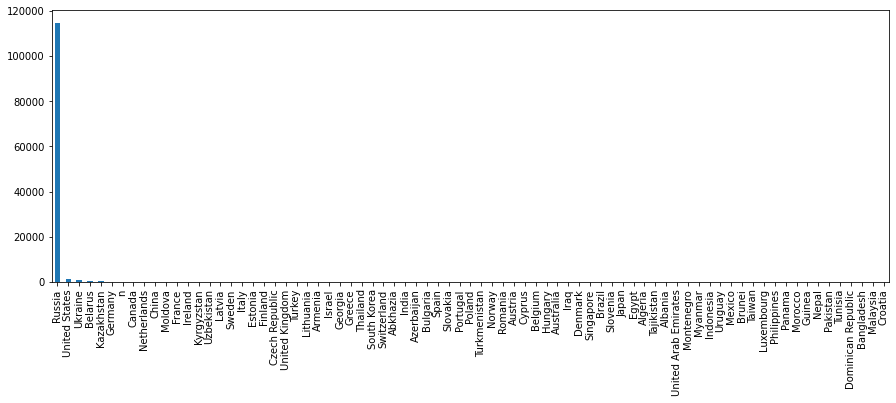

In [79]:
country1 = v['Country'].value_counts()
country1.plot(kind='bar', figsize=(15, 5))

Позднее посмотрим на подозрительный трафик исходящий из United States и некоторых других стран, которые в Вебвизоре определились, как почтовые боты.

### 2.4. Города (все данные). <a id='102103'></a>

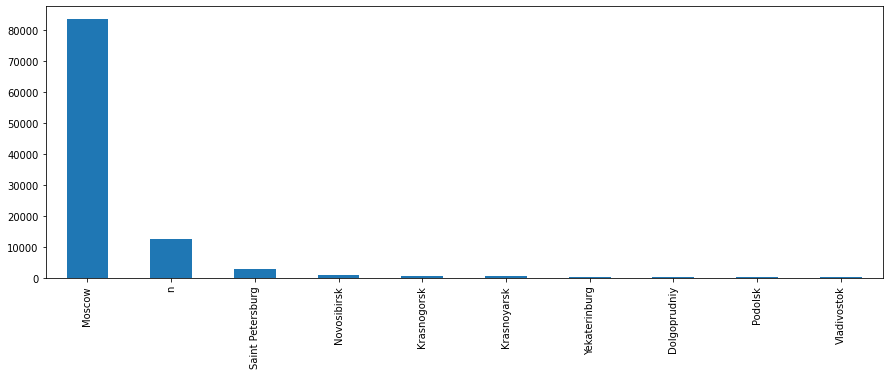

In [80]:
city1 = v['City'].value_counts().head(10)
city1.plot(kind='bar', figsize=(15, 5))

### 2.5. Посетители приходящие по рекламе Яндекс.Директ. <a id='102104'></a>

In [81]:
v['TrafficSource'].value_counts()

ad           62471
organic      26566
direct       19020
internal      5560
referral      4091
undefined      466
social         122
saved           38
messenger        1
recommend        1
Name: TrafficSource, dtype: int64

Сделаем воронку, только не продаж, а источников заходов :), messendger и recommend не включим, т.к. они практически не представлены.

In [82]:
fig2 = go.Figure(go.Funnel(
    y = ["ad - Яндекс.Директ", "organic - заходы из поиска", "direct - прямые заходы", "internal - внутренние переходы", 
         "referral - переходы с др. сайтов", "undefined - не определено (чаще всего это Я.Директ)",
         "social - переходы из соцсетей", "saved - заходы по сохр. ссылкам"],
    x = [62471, 26566,  19020, 5560, 4091, 466, 122, 38], 
    textposition = "inside", 
    textinfo = "value+percent initial", 
    opacity = 0.8, marker = {"color": ["deepskyblue", "lightsalmon", "tan", "teal", "rosybrown", "tomato", 
                                        "darkseagreen", "olive", "sandybrown"], 
                              "line": {"width": [4, 2, 2, 2, 2, 1, 1, 1], "color": ["blue", "wheat", "wheat", "wheat", "wheat", "wheat", "wheat", "wheat"]}}, 
    connector = {"line": {"color": "royalblue", "dash": "dot", "width": 3}}))

fig2.write_image('tron1.jpeg')
fig2.show()

### 2.6. Визиты во времени. <a id='102105'></a>

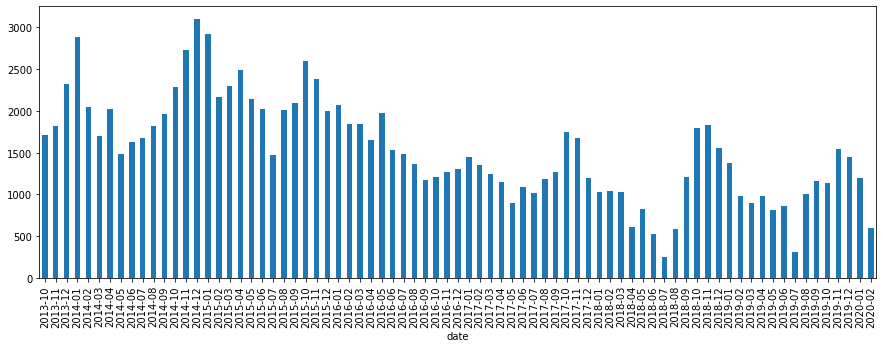

In [83]:
viz = v.groupby('date')['visitID'].count().sort_values().sort_index()
viz.plot(y='date', kind='bar', figsize=(15, 5))

### 2.7. Минуты на сайте во времени. <a id='102106'></a>

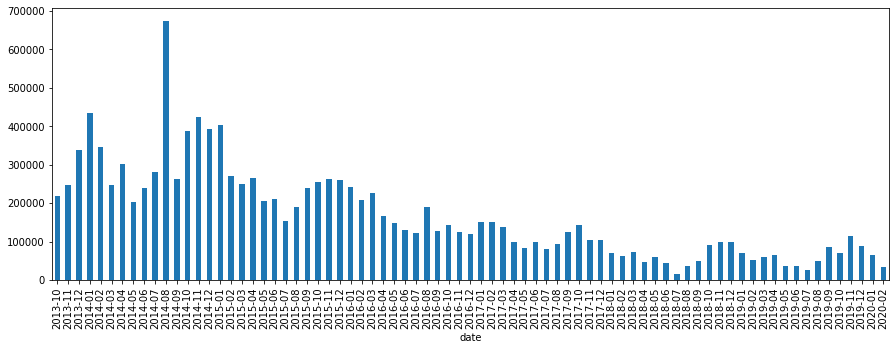

In [84]:
minutes = v.groupby('date')['visitDuration'].sum().sort_values().sort_index()
minutes.plot(y='date', kind='bar', figsize=(15, 5))

## 3. Исследование отказов. <a id='100103'></a>

### 3.1. Общий обзор. <a id='103100'></a>

Разделим все данные по отказам, но возьмем данные с 2018 года, т.к. нужно знать ситуацию за последнее время.

In [85]:
v1 = v.query('date > "2017-12"')
BOU = v1.query('bounce == 1')
NOU = v1.query('bounce == 0')

In [86]:
BOU.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,8.383000e+03,8383,8383,8383.0,8383.000000,8383.0,8383,8383,8383,8.383000e+03,8383,8383,8383,8383,8383,8383,8383,8383,8383,8383,8383,8383,8.383000e+03,8383.000000,8383.0,8383,8383,8383,8383,8383,8383,8383.000000,8383.0,8383.0,8383.0,8383.0,8383.0,8383.0,8383.0,8383,8383.0,8383,8383
unique,NaN,8365,115,NaN,NaN,NaN,2860,42,229,NaN,5,8,2,118,6,11,123,16,26,152,3,109,NaN,NaN,4.0,47,476,7,51,34,7,NaN,27.0,5.0,3.0,123.0,148.0,88.0,140.0,26,7.0,1418,24
top,NaN,2018-01-16 06:34:25,n,NaN,NaN,NaN,66.249.89.xxx,Russia,Moscow,NaN,none,ad,ya_undefined,n,n,n,n,n,0,n,n,n,NaN,NaN,1.0,n,n,windows,n,n,WebKit,NaN,28.0,24.0,2.0,1400.0,1024.0,1400.0,1024.0,2018-10,3.0,17-02,с 17 до 18
freq,NaN,2,1654,NaN,NaN,NaN,1172,7342,4215,NaN,5349,5065,5176,4252,4693,4693,7822,5176,5176,5378,5378,5378,NaN,NaN,5324.0,5384,5367,2800,2192,2194,4999,NaN,3300.0,5958.0,5573.0,1554.0,1888.0,1554.0,1780.0,674,1388.0,26,494
first,NaN,2018-01-01 12:21:31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-02-15 19:53:41,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5.349832e+18,NaN,NaN,1.0,0.089944,1.0,NaN,NaN,NaN,2.444847e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-8.571693e+08,2.096147,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.996898,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,4.425900e+18,NaN,NaN,0.0,0.930038,0.0,NaN,NaN,NaN,3.705711e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.165720e+09,294.270743,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.055608,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.824104e+15,NaN,NaN,1.0,0.000000,1.0,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-660.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,2.165398e+18,NaN,NaN,1.0,0.000000,1.0,NaN,NaN,NaN,1.535543e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-420.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [87]:
bou_B = BOU['bounce'].value_counts()
dur_B = BOU['visitDuration'].value_counts()
nt_B = BOU['networkType'].value_counts()
bann_B = BOU['OpenstatAd'].value_counts()
be_B = BOU['ReferalSource'].value_counts()
TS_B = BOU['TrafficSource'].value_counts()
ad_B = BOU['AdvEngine'].value_counts()
er_B = BOU['EngineRoot'].value_counts()
SE_B = BOU['SearchEngine'].value_counts()
OSR_B = BOU['operatingSystemRoot'].value_counts()
OS_B = BOU['browser'].value_counts()
d_B = BOU['deviceCat'].value_counts()

In [88]:
print("Отток: ", bou_B, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_B/83.83, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_B/83.83, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_B/83.83,     
      sep='')

Отток: 1    8383
Name: bounce, dtype: int64
_________________________________________________
Время визита в секундах: 0     98.807110
6      0.119289
12     0.107360
11     0.107360
9      0.107360
14     0.095431
5      0.095431
3      0.095431
1      0.095431
10     0.083502
2      0.071573
4      0.059645
8      0.059645
7      0.047716
13     0.047716
Name: visitDuration, dtype: float64
_________________________________________________
Тип соединения: none        63.807706
other       16.473816
cellular    11.070023
wi_fi        8.624597
ethernet     0.023858
Name: networkType, dtype: float64
_________________________________________________
OpenstatAD: -2147483648    44.017655
 0             39.568174
 443557724      7.992366
 443557744      3.686031
 443557769      3.256591
 1575371704     1.371824
 1              0.035787
 245180354      0.023858
 443557768      0.023858
 497635172      0.011929
 187521943      0.011929
Name: OpenstatAd, dtype: float64
_________________________

- Среди отказов выделяется IP 66.249.89.xxx - 14%.
- в 98,8 случаях время визита - 0 секунд, в отказы записывают только время до 15 секунд.
- 87.6% посетителей из России.
- 50.3% посетителей из Москвы.
- тип соединения в 63.8% случаев не определяется, в 16,5% - это "other", т.е. тоже неизвестно, в 11% - это 3G-4G, в 8.6% - это wi-fi.
- среди OpenstatAD - (-2147483648) - составляет 44%, (0) - 39,6%.
- 60.4% трафика среди отказов идет из рекламы Яндекс.Директа, прямые заходы - 28,7%, из поиска - 6,6%.
- переходы с других сайтов: yabs.yandex.ru - в 34.4% случаев, с yandex.ru - 6,9%.
- в 56% случаев поисковые системы неизвестны, но в 41,3% - это Yandex, Google - всего 2%. 
- в 7% случаев переход среди отказов происходит по реферальным ссылкам.
- примерно в 62% случаев объявления, рекламные площадки и фразы, с которых происходит переход, не определяются.
- 63.5% посетителей заходят со стационарного компьютера, с мобильного телефона - 33,5%, с планшета - 3%.
- 33.4% посетителей пользуются Windows, 21,15% - Android, 15.2% - ios_double.
- в 26.1% случаев браузер неизвестен, в 14% это chrome, в 13% - yandex_browser, в 11,5% safari_mobile, в 9,5% msie, а движков браузеров преобладает WebKit - 59.6%.
- в среднем размер экрана 1400 на 1024 совпадает с физическим.
- больше всего отказов в октябре 2018, чаще всего примерно в 17:00, по четвергам.

In [89]:
NOU.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,1.821300e+04,18213,18213,18213.000000,18213.000000,18213.0,18213,18213,18213,1.821300e+04,18213,18213,18213,18213,18213,18213,18213,18213,18213,18213,18213,18213,1.821300e+04,18213.000000,18213.0,18213,18213,18213,18213,18213,18213,18213.000000,18213.0,18213.0,18213.0,18213.0,18213.0,18213.0,18213.0,18213,18213.0,18213,18213
unique,NaN,18203,125,NaN,NaN,NaN,7429,47,363,NaN,6,8,2,203,7,13,456,16,26,184,3,310,NaN,NaN,4.0,58,934,8,54,37,7,NaN,31.0,5.0,3.0,206.0,252.0,126.0,208.0,26,7.0,1418,24
top,NaN,2018-12-10 06:25:16,n,NaN,NaN,NaN,83.220.238.xxx,Russia,Moscow,NaN,none,ad,ya_direct,yabs.yandex.ru,yandex,yandex_search,n,n,0,n,Search,yandex.ru,NaN,NaN,2.0,n,n,windows,windows_7_2008server,yandex_browser,WebKit,NaN,11.0,24.0,1.0,360.0,640.0,1080.0,1080.0,2018-11,0.0,22-05,с 22 до 23
freq,NaN,3,3795,NaN,NaN,NaN,226,17831,14216,NaN,11976,12296,11106,9118,12385,10836,15640,7107,7107,7617,8933,8738,NaN,NaN,9102.0,8248,8159,7651,3623,4452,16502,NaN,5859.0,13231.0,9154.0,4286.0,3031.0,3238.0,2737.0,1205,3152.0,30,1226
first,NaN,2018-01-01 04:21:06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-02-15 21:40:20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5.158308e+18,NaN,NaN,1.763356,87.990446,0.0,NaN,NaN,NaN,2.362211e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-8.284231e+08,191.648218,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.998408,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,4.485975e+18,NaN,NaN,1.942537,252.080600,0.0,NaN,NaN,NaN,3.574989e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.194338e+09,79.778597,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.039873,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.477582e+15,NaN,NaN,1.000000,0.000000,0.0,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-660.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,1.663765e+18,NaN,NaN,1.000000,15.000000,0.0,NaN,NaN,NaN,1.527228e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,180.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [90]:
bou_N = NOU['bounce'].value_counts()
dur_N = NOU['visitDuration'].value_counts()
nt_N = NOU['networkType'].value_counts()
bann_N = NOU['OpenstatAd'].value_counts()
be_N = NOU['ReferalSource'].value_counts()
TS_N = NOU['TrafficSource'].value_counts()
ad_N = NOU['AdvEngine'].value_counts()
er_N = NOU['EngineRoot'].value_counts()
SE_N = NOU['SearchEngine'].value_counts()
OSR_N = NOU['operatingSystemRoot'].value_counts()
OS_N = NOU['browser'].value_counts()
d_N = NOU['deviceCat'].value_counts()

In [91]:
print("Отток: ", (bou_N), '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_N/182.13, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_N/182.13, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_N/182.13,     
      sep='')

Отток: 0    18213
Name: bounce, dtype: int64
_________________________________________________
Время визита в секундах: 15      46.851150
16      10.135617
14       2.278592
17       1.542854
18       1.043211
          ...    
792      0.005491
744      0.005491
2745     0.005491
664      0.005491
1367     0.005491
Name: visitDuration, Length: 1069, dtype: float64
_________________________________________________
Тип соединения: none         65.755230
cellular     18.980948
wi_fi        15.247351
other         0.005491
ethernet      0.005491
bluetooth     0.005491
Name: networkType, dtype: float64
_________________________________________________
OpenstatAD: -2147483648    44.122330
 0             32.531708
 443557724     11.974963
 443557769      5.671773
 443557744      4.156372
 1575371704     1.400099
 1              0.082359
 877994451      0.021962
 443557768      0.010981
 245128606      0.010981
 443557738      0.005491
 245134130      0.005491
 443557772      0.005491
Name: O

In [92]:
desktop = v.query('deviceCat == 1')
phone = v.query('deviceCat == 2')
mobcomp = v.query('deviceCat == 3')

d1 = desktop.query('bounce == 1')
print('% отказов среди ПК: {:.1f}'.format(len(d1)/len(desktop)*100))

p1 = phone.query('bounce == 1')
print('% отказов среди телефонов: {:.1f}'.format(len(p1)/len(phone)*100))

m1 = mobcomp.query('bounce == 1')
print('% отказов среди планшетов: {:.1f}'.format(len(m1)/len(mobcomp)*100))

% отказов среди ПК: 24.7
% отказов среди телефонов: 22.6
% отказов среди планшетов: 18.1


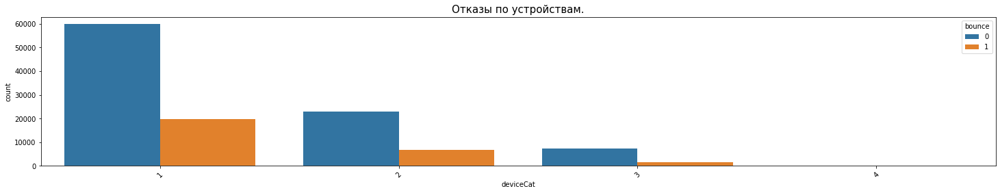

In [93]:
plt.figure(figsize=(25, 4))
sns.countplot(x='deviceCat', hue='bounce', data=v)
plt.title('Отказы по устройствам.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

- 15 секунд визита преобладает - 46,8% (особенности Яндекса), 16 секунд - 10,13%.
- Среди визитов выделяется IP 83.220.238.xxx - 1,24%.
- 97.9% посетителей из России.
- 78% посетителей из Москвы.
- тип соединения в 65.7% случаев не определяется, в 19% это 3G-4G, в 15% это wi-fi.
- 67.5% трафика идет из рекламы Яндекс.Директа, 18,1% - из поиска, 9,3% - прямые заходы, 4% - внутренние переходы.
- среди OpenstatAD - (-2147483648) - составляет 44,12%, (0) - 32,5%.
- переходы с других сайтов: yabs.yandex.ru - в 50% случаев, с yandex.ru - 18%, в 20% неизвестно.
- в 14% случаев переход происходит по реферальным ссылкам, что в 2 раза больше чем в отказах.
- примерно в 40% случаев объявления, рекламные площадки и фразы, с которых происходит переход, не определяются, это на треть меньше чем среди отказов.
- yandex лидирует среди поисковых систем - 68%, в 26,6% случаев поисковые системы неизвестны, Google - 4%.
- 50% посетителей заходят с мобильного телефона! главное отличие от отказов! 44,3% со стационарного компьютера, 5,6% с планшета, при этом отток: среди ПК - 24.7%, среди телефонов: 22.6%, среди планшетов: 18.1%.
- 42% посетителей пользуются Windows, 35,8% - Android, 19.6% - ios_double.
- в 24.4% случаев браузер yandex-direct, в 18,5% - chrome, в 14,5% - safari_mobile, в 12,6 - chromemobile, в 7.3% - yandexsearch, а среди движков браузеров преобладает WebKit - 90.6% (что на треть больше чем в отказах), а неизвестных браузеров крайне мало.
- в среднем размер экрана 360 на 640, а физический 1080 на 1080.
- больше всего визитов в ноябре 2018, чаще всего примерно в 22:00, по понедельникам.

### 3.2. Отказы и неотказы во времени. <a id='103101'></a>

In [94]:
#здесь будем смотреть данные за все время:
BOU1 = v.query('bounce == 1')
NOU1 = v.query('bounce == 0')

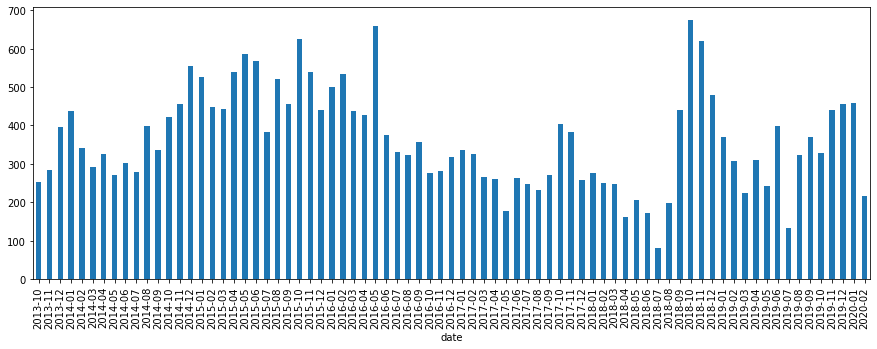

In [95]:
fr = BOU1.groupby('date')['visitID'].count().sort_values().sort_index()
fr.plot(y='date', kind='bar', figsize=(15, 5))

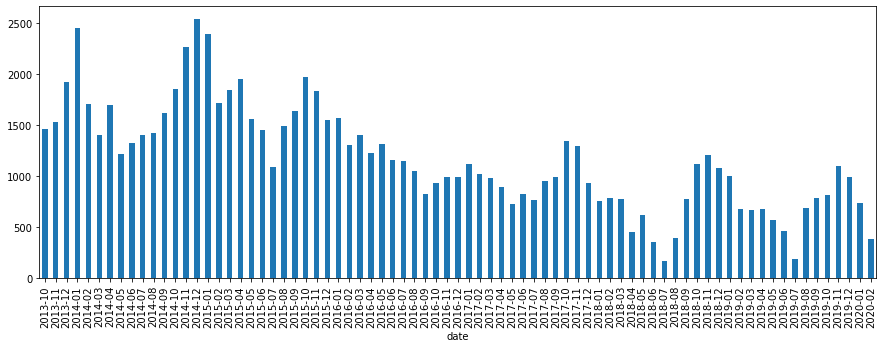

In [96]:
fr01 = NOU1.groupby('date')['visitID'].count().sort_values().sort_index()
fr01.plot(y='date', kind='bar', figsize=(15, 5))

Нужно посмотреть подробнее признаки в которых обнаружились главные различия:
- IP,
- источники трафика,
- время визитов,
- тип соединения,
- поисковые системы,
- устройства,
- операционные системы.
* А также исследовать  IP 83.220.238.xxx, IP 66.249.89.xxx.

### 3.3. Количество секунд разделенных по источникам трафика среди отказов и неотказов. Пропущенные нулевые визиты во времени и по источникам трафика. <a id='103102'></a>

(2416.5, -0.5)

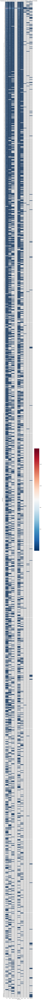

In [97]:
sk_0 = NOU1.pivot_table(index=['visitDuration'], columns=['TrafficSource'], values='visitID', aggfunc='count')
plt.figure(figsize=(10, 300))
plt.title('Количество секунд разделенных по источникам трафика среди не-отказов.', fontsize=15) 
ax = sns.heatmap(sk_0, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Среди неотказов преобладает 14, 15, 16 секунд в Я.Директе, по прямым заходам, переходам из поиска затем по внутренним переходам.

(15.5, -0.5)

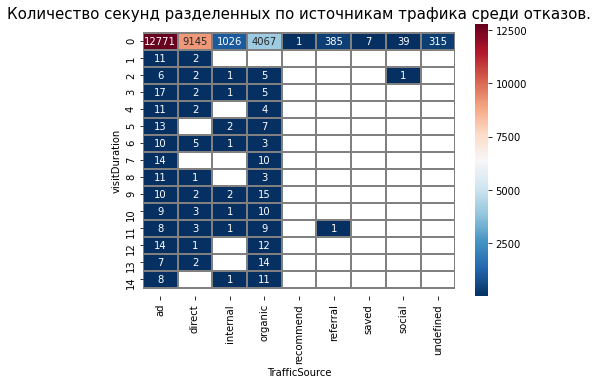

In [98]:
sk_1 = BOU1.pivot_table(index=['visitDuration'], columns=['TrafficSource'], values='visitID', aggfunc='count')
plt.figure(figsize=(7, 5))
plt.title('Количество секунд разделенных по источникам трафика среди отказов.', fontsize=15) 
ax = sns.heatmap(sk_1, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Отказы ограничиваются 14-ю секундами, в них преобладает 0 секунд в Я.Директе, по прямым заходам, переходам из поиска, затем по внутренним переходам.

### Пропущенные нулевые визиты во времени и по источникам трафика.

(58.5, -0.5)

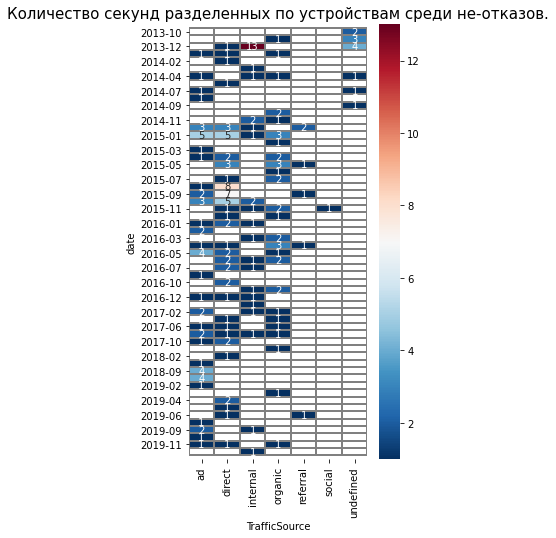

In [99]:
gg = v.query('visitDuration == 0 and bounce == "0"')
#gg01 = gg.groupby('date')['visitID'].count().sort_values().sort_index()
#gg01.plot(y='date', kind='bar', figsize=(10, 4))

gg_0 = gg.pivot_table(index=['date'], columns=['TrafficSource'], values='visitID', aggfunc='count')
plt.figure(figsize=(4, 8))
plt.title('Количество секунд разделенных по устройствам среди не-отказов.', fontsize=15) 
ax = sns.heatmap(gg_0, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Были подозрения, что Яндекс пропускает много 0-х кликов, но эти подозрения не подтвердились - в Я.Директе их мало и со временем они снижаются по всем источникам.

### 3.4. Количество секунд по устройствам и датам среди отказов и неотказов. <a id='103103'></a>

(77.5, -0.5)

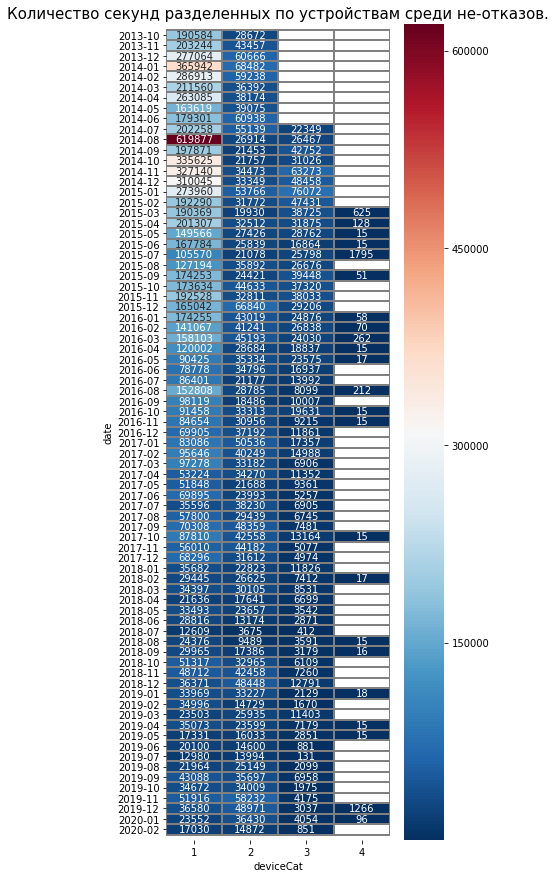

In [100]:
br_0 = NOU1.pivot_table(index=['date'], columns=['deviceCat'], values='visitDuration', aggfunc='sum')
plt.figure(figsize=(5, 15))
plt.title('Количество секунд разделенных по устройствам среди не-отказов.', fontsize=15) 
ax = sns.heatmap(br_0, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Больше всего (среди нерекламных визитов) минут было проведено на сайте в августе 2014-го, и большее количество времени посетители стационарных ПК проводят на сайте.

(77.5, -0.5)

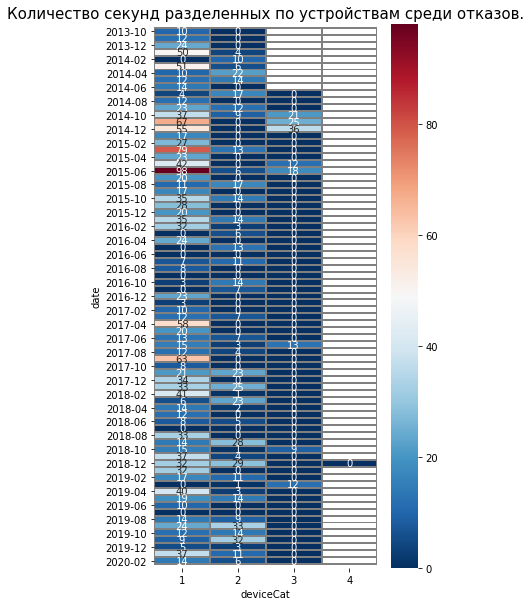

In [101]:
br_1 = BOU1.pivot_table(index=['date'], columns=['deviceCat'], values='visitDuration', aggfunc='sum')
plt.figure(figsize=(5, 10))
plt.title('Количество секунд разделенных по устройствам среди отказов.', fontsize=15) 
ax = sns.heatmap(br_1, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Среди отказов так же преобладают стационарные ПК, но максимальное количество времени было проведено на сайте в июне 2015-го.

### 3.5. Количество визитов по устройствам и временным зонам среди отказов и неотказов. <a id='103104'></a>

(36.5, -0.5)

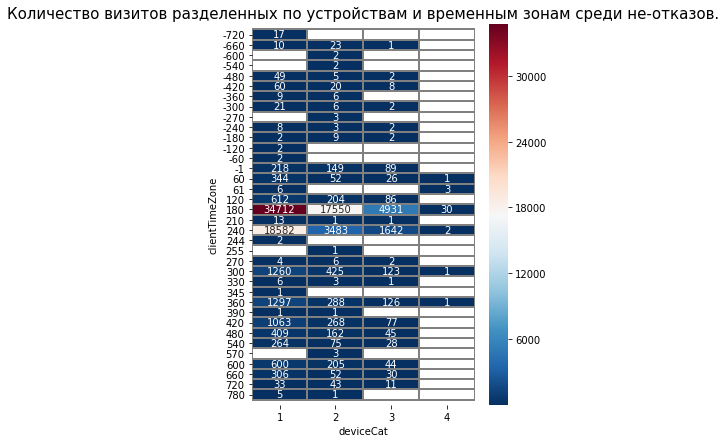

In [102]:
tm_0 = NOU1.pivot_table(index=['clientTimeZone'], columns=['deviceCat'], values='visitID', aggfunc='count')
plt.figure(figsize=(5, 7))
plt.title('Количество визитов разделенных по устройствам и временным зонам среди не-отказов.', fontsize=15) 
ax = sns.heatmap(tm_0, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

(33.5, -0.5)

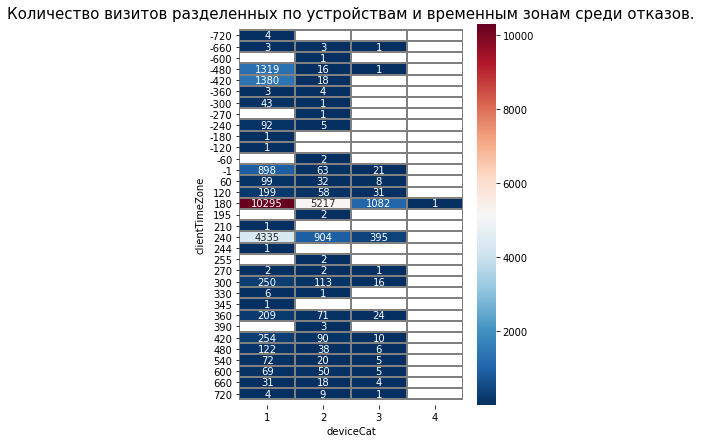

In [103]:
tm_1 = BOU1.pivot_table(index=['clientTimeZone'], columns=['deviceCat'], values='visitID', aggfunc='count')
plt.figure(figsize=(5, 7))
plt.title('Количество визитов разделенных по устройствам и временным зонам среди отказов.', fontsize=15) 
ax = sns.heatmap(tm_1, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Сходство между отказами и неотказами - преобладают визиты из зон +3 и +4 часа, но у отказов выделяется группа со стационарных ПК в зоне -7 и -8 часов.

### 3.6. Количество визитов разделенное по операционным системам и минутам проведенным на сайте среди отказов и неотказов. <a id='103105'></a>

(2416.5, -0.5)

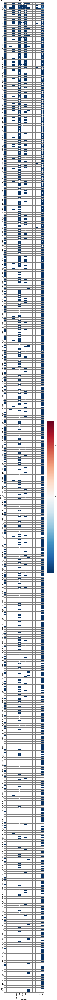

In [104]:
osr_0 = NOU1.pivot_table(index=['visitDuration'], columns=['operatingSystemRoot'], values='visitID', aggfunc='count')
plt.figure(figsize=(15, 300))
plt.title('Количество визитов разделенное по ОС и минутам проведенным на сайте среди не-отказов.', fontsize=15) 
ax = sns.heatmap(osr_0, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

(15.5, -0.5)

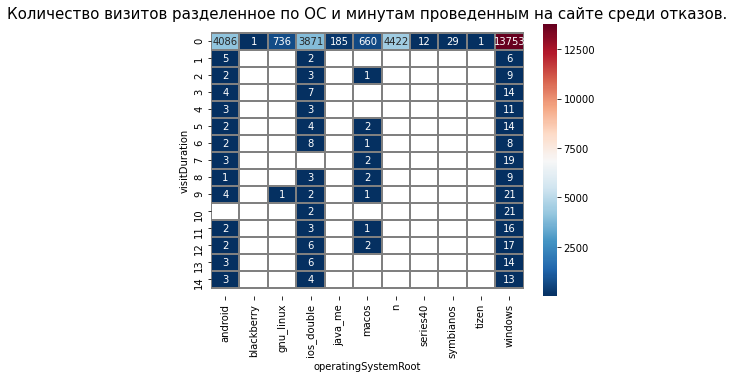

In [105]:
osr_1 = BOU1.pivot_table(index=['visitDuration'], columns=['operatingSystemRoot'], values='visitID', aggfunc='count')
plt.figure(figsize=(7, 5))
plt.title('Количество визитов разделенное по ОС и минутам проведенным на сайте среди отказов.', fontsize=15) 
ax = sns.heatmap(osr_1, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Отказы и неотказы похожи (разница только в секундах - 0 у отказов, а 15,16 преобладает у неотказов) - кроме того, что у отказов много визитов из неизвестных ОС.

### 3.7. Среднее количество секунд просмотра по браузерам среди неотказов. <a id='103106'></a>

- Смотрим данные начиная с 2018 года!

**Так как отказы в большинстве это нулевые визиты, информации о средних количествах практически нет, поэтому исследуем неотказные визиты.**

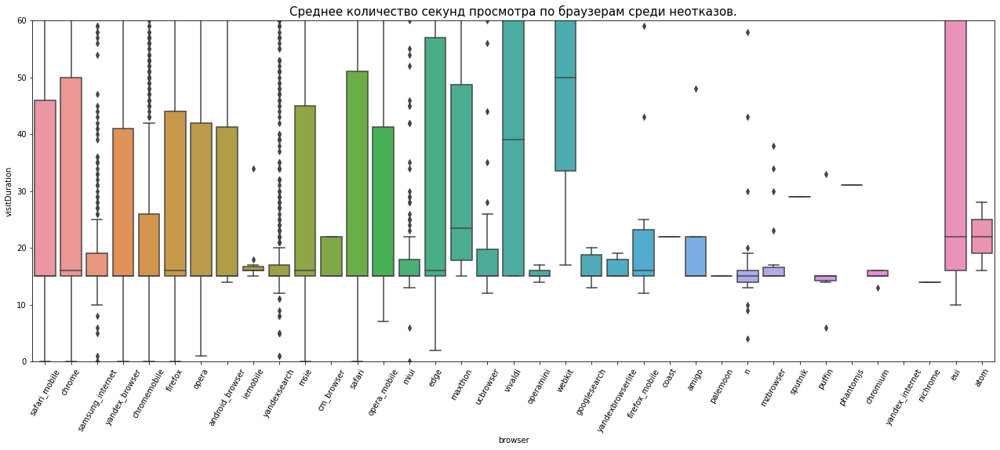

In [106]:
plt.figure(figsize=(22, 8))
sns.boxplot(x="browser", y="visitDuration", data=NOU)
plt.ylim(0, 60)
plt.title('Среднее количество секунд просмотра по браузерам среди неотказов.', fontsize=15) 
plt.xticks(rotation=60)
plt.show()

Среди неотказов среднее количество секунд просмотра 15-16, выделяются браузеры - vivaldi и webkit - 40-50 секунд в среднем.

### 3.8. Среднее количество секунд просмотра по операционным системам среди неотказов. <a id='103107'></a>

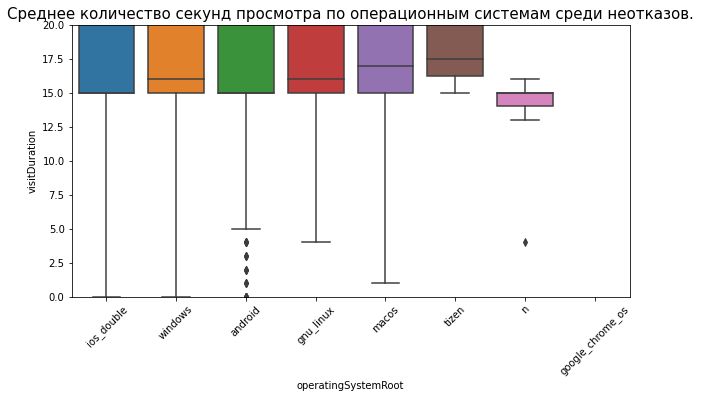

In [107]:
plt.figure(figsize=(10, 5))
sns.boxplot(x="operatingSystemRoot", y="visitDuration", data=NOU)
plt.ylim(0, 20)
plt.title('Среднее количество секунд просмотра по операционным системам среди неотказов.', fontsize=15) 
plt.xticks(rotation=45)
plt.show()

Среднее количество секунд во всех ОС - 15-17.

### 3.9. Среднее количество секунд просмотра по поисковым системам среди неотказов. <a id='103108'></a>

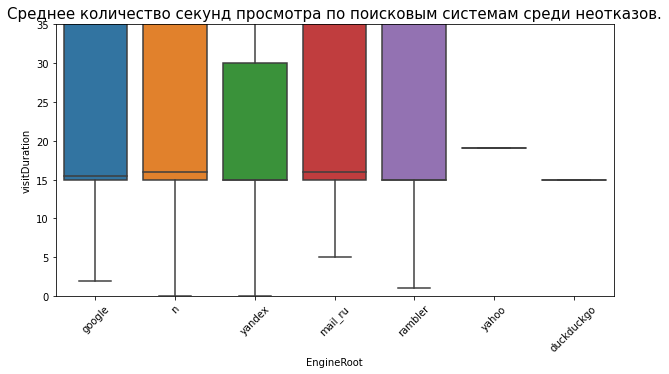

In [108]:
plt.figure(figsize=(10, 5))
sns.boxplot(x="EngineRoot", y="visitDuration", data=NOU)
plt.ylim(0, 35)
plt.title('Среднее количество секунд просмотра по поисковым системам среди неотказов.', fontsize=15) 
plt.xticks(rotation=45)
plt.show()

Среднее количество секунд по всем поисковым системам - 15-17.

### 3.10. Среднее количество секунд просмотра по источникам трафика среди неотказов. <a id='103109'></a>

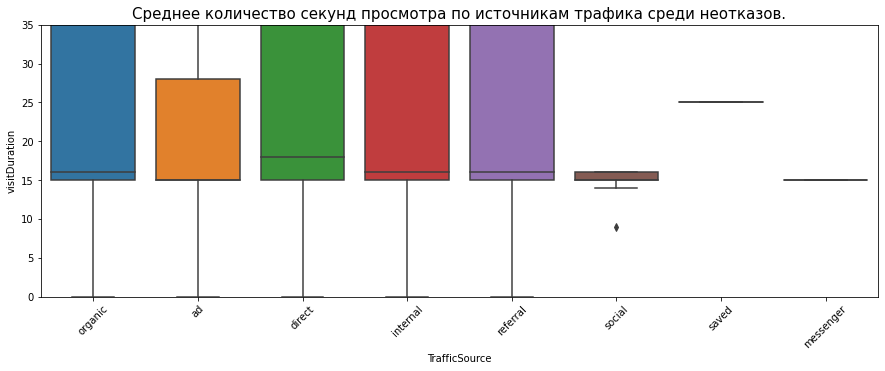

In [109]:
plt.figure(figsize=(15, 5))
sns.boxplot(x="TrafficSource", y="visitDuration", data=NOU)
plt.ylim(0, 35)
plt.title('Среднее количество секунд просмотра по источникам трафика среди неотказов.', fontsize=15) 
plt.xticks(rotation=45)
plt.show()

Ниже всего среднее количество секунд на сайте - 15 из Я.Директа (возможно это искусственно заниженное отображение), 16 секунд - из поиска, внутренних и реферальных переходов, больше всего (18 сек) - проводят пользователи пришедшие по прямым заходам. 

### 3.11. Среднее количество секунд просмотра по типам соединения среди неотказов. <a id='103110'></a>

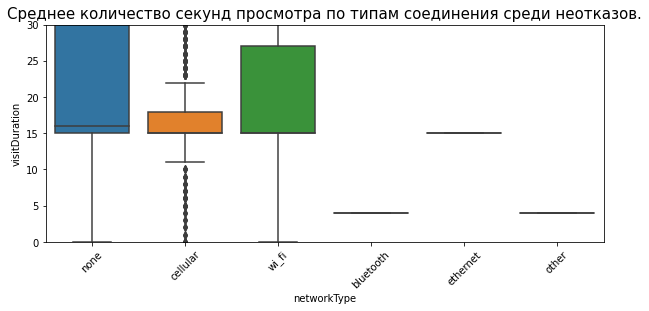

In [110]:
plt.figure(figsize=(10, 4))
sns.boxplot(x="networkType", y="visitDuration", data=NOU)
plt.ylim(0, 30)
plt.title('Среднее количество секунд просмотра по типам соединения среди неотказов.', fontsize=15) 
plt.xticks(rotation=45)
plt.show()

Среднее количество секунд 15-16, выделяется 3G-4G - много выбросов.

### 3.12. Среднее количество секунд на сайте по устройствам среди неотказов. <a id='103111'></a>

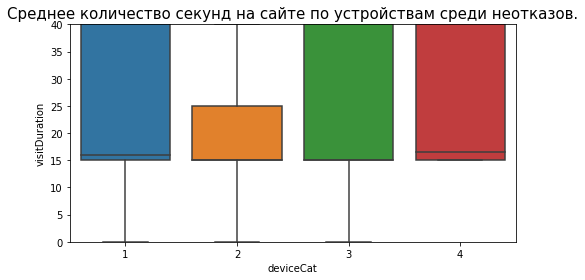

In [111]:
plt.figure(figsize=(8, 4))
sns.boxplot(x="deviceCat", y="visitDuration", data=NOU)
plt.ylim(0, 40)
plt.title('Среднее количество секунд на сайте по устройствам среди неотказов.', fontsize=15) 
plt.show()

Среднее количество секунд по устройствам - 15-17. С планшетов пользователи смотрят сайт дольше.

По всем неотказам очень много выбросов.

## 4. Исследование рекламных и нерекламных визитов раздельно. <a id='100104'></a>

Возьмем данные начиная с 2018 года, т.к. нужна актуальная информация.

In [112]:
v2 = v.query('date > "2017-12"')

In [113]:
#т.к. наша главная цель исследовать переходы по рекламе, отберем данные по этому критерию
AD = v2.query('TrafficSource == ("ad", "undefined")')
#так же сразу сделаем срез с остальной группой посетителей, для дальнейшего исследования и сравнения:
OTH = v2.query('TrafficSource != ("ad", "undefined")')

### 4.1. Общие данные по рекламным и нерекламным визитам. <a id='104100'></a>

In [114]:
AD.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,1.738200e+04,17382,17382,17382.000000,17382.000000,17382.000000,17382,17382,17382,1.738200e+04,17382,17382,17382,17382,17382,17382,17382,17382,17382,17382,17382,17382,1.738200e+04,17382.000000,17382.0,17382,17382,17382,17382,17382,17382,17382.000000,17382.0,17382.0,17382.0,17382.0,17382.0,17382.0,17382.0,17382,17382.0,17382,17382
unique,NaN,17370,71,NaN,NaN,NaN,5937,25,165,NaN,5,2,2,173,5,8,82,16,26,187,3,362,NaN,NaN,4.0,58,872,8,49,35,7,NaN,33.0,4.0,3.0,195.0,241.0,107.0,191.0,26,7.0,1421,24
top,NaN,2018-12-10 06:25:16,http://dopservis.ru/uslugi/pandora/avtosignalizatsiya-pandora-dxl-3910/,NaN,NaN,NaN,66.249.89.xxx,Russia,Moscow,NaN,none,ad,ya_direct,yabs.yandex.ru,yandex,yandex_search,n,n,0,n,Search,yandex.ru,NaN,NaN,2.0,n,n,android,windows_7_2008server,yandex_browser,WebKit,NaN,11.0,24.0,1.0,360.0,640.0,1080.0,1080.0,2018-10,3.0,22-47,с 22 до 23
freq,NaN,3,4117,NaN,NaN,NaN,1018,16997,14746,NaN,10276,17361,14313,12003,12962,12027,16738,3069,3069,3781,11588,11329,NaN,NaN,8814.0,7833,7761,6191,2889,4177,14597,NaN,5659.0,12517.0,8865.0,4102.0,2805.0,3088.0,2263.0,1401,3084.0,34,1286
first,NaN,2018-01-01 09:02:52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-02-15 21:40:20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5.147809e+18,NaN,NaN,1.420435,46.663330,0.292602,NaN,NaN,NaN,2.435597e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.280807e+09,136.181682,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.997584,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,4.343492e+18,NaN,NaN,1.261766,162.305794,0.454970,NaN,NaN,NaN,3.676211e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.257615e+09,172.769239,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.049098,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,5.356470e+15,NaN,NaN,1.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-660.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,1.707900e+18,NaN,NaN,1.000000,0.000000,0.000000,NaN,NaN,NaN,1.534622e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,180.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [115]:
bou_ad = AD['bounce'].value_counts()
dur_ad = AD['visitDuration'].value_counts()
nt_ad = AD['networkType'].value_counts()
bann_ad = AD['OpenstatAd'].value_counts()
be_ad = AD['ReferalSource'].value_counts()
TS_ad = AD['TrafficSource'].value_counts()
ad_ad = AD['AdvEngine'].value_counts()
er_ad = AD['EngineRoot'].value_counts()
SE_ad = AD['SearchEngine'].value_counts()
OSR_ad = AD['operatingSystemRoot'].value_counts()
OS_ad = AD['browser'].value_counts()
d_ad = AD['deviceCat'].value_counts()
tz_ad = AD['clientTimeZone'].value_counts()

In [116]:
print("Отток: ", (bou_ad)/173.82, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_ad/173.82, '\n',
      "_________________________________________________", '\n',
      "Временная зона: ", tz_ad/173.82, '\n',
      sep='')

Отток: 0    70.739846
1    29.260154
Name: bounce, dtype: float64
_________________________________________________
Время визита в секундах: 15      37.038315
0       28.966747
16       6.759867
14       1.432516
17       0.983776
          ...    
1592     0.005753
3641     0.005753
1624     0.005753
1688     0.005753
1735     0.005753
Name: visitDuration, Length: 725, dtype: float64
_________________________________________________
Тип соединения: none        59.118628
cellular    19.301576
wi_fi       14.762398
other        6.800138
ethernet     0.017259
Name: networkType, dtype: float64
_________________________________________________
OpenstatAD: -2147483648    67.431826
 443557724     16.402025
 443557769      7.513520
 443557744      6.132781
 1575371704     2.128639
 0              0.189852
 1              0.103555
 443557768      0.023012
 877994451      0.023012
 245180354      0.011506
 245128606      0.011506
 443557738      0.005753
 497635172      0.005753
 187521943     

- отток 29,2%.
- 15 секунд визита преобладает - 37% (особенности Яндекса), 0 секунд - 29%.
- Среди визитов выделяется IP 66.249.89.xxx - требует исследования.
- 98% посетителей из России, бОльшая часть из Москвы.
- тип соединения в 59% случаев не определяется, в 19,3% это 3G-4G, в 14,7% это wi-fi.
- среди OpenstatAD - (-2147483648) - составляет 67,4%.
- переходы с других сайтов: yabs.yandex.ru - в 69% случаев, с yandex.ru - 5,6%, в 21% неизвестно.
- в 3,7% случаев переход происходит по реферальным ссылкам.
- примерно в 20% случаев объявления, рекламные площадки и фразы, с которых происходит переход, не определяются.
- yandex лидирует среди поисковых систем - 69%, в 24% случаев поисковые системы неизвестны.
- 50% посетителей заходят с мобильного телефона! главное отличие от отказов! 44,3% со стационарного компьютера, 5,6% с планшета.
- среди ОС лидирует Android - 35,6%, windows - 35%, ios_double - 20%.
- в 24% случаев браузер yandex-browser, в 14% - chrome, в 14% - safari_mobile, в 10 - chromemobile, в 9% - yandexsearch, а среди движков браузеров преобладает WebKit - 84%, а неизвестных браузеров 7,7%.
- в среднем размер экрана 360 на 640, а физический 1080 на 1080.
- больше всего визитов по рекламе в октябре 2018, чаще всего примерно в 23:00, по четвергам.

In [117]:
OTH.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,9.214000e+03,9214,9214,9214.000000,9214.000000,9214.000000,9214,9214,9214,9.214000e+03,9214,9214,9214,9214,9214,9214,9214,9214,9214,9214,9214,9214,9.214000e+03,9214.000000,9214.0,9214,9214,9214,9214,9214,9214,9214.000000,9214.0,9214.0,9214.0,9214.0,9214.0,9214.0,9214.0,9214,9214.0,9214,9214
unique,NaN,9202,122,NaN,NaN,NaN,3960,56,400,NaN,5,8,1,109,7,13,467,1,1,1,1,1,NaN,NaN,4.0,44,504,7,54,36,7,NaN,28.0,5.0,3.0,145.0,168.0,108.0,144.0,26,7.0,1412,24
top,NaN,2019-06-18 17:02:13,http://dopservis.ru/,NaN,NaN,NaN,23.100.232.xxx,Russia,Moscow,NaN,none,direct,ya_undefined,n,n,n,n,n,0,n,n,n,NaN,NaN,1.0,n,n,windows,windows_7_2008server,chrome,WebKit,NaN,37.0,24.0,2.0,1024.0,768.0,1920.0,768.0,2019-11,1.0,17-02,с 17 до 18
freq,NaN,2,2827,NaN,NaN,NaN,658,8176,3685,NaN,7049,4103,9214,4104,5356,5356,6724,9214,9214,9214,9214,9214,NaN,NaN,5710.0,5799,5765,4365,2000,2049,6904,NaN,2604.0,6672.0,6127.0,1574.0,2246.0,1358.0,1612.0,650,1466.0,29,586
first,NaN,2018-01-01 04:21:06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-02-15 20:54:23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5.352364e+18,NaN,NaN,1.715759,85.980247,0.357825,NaN,NaN,NaN,2.298953e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.165337e+06,123.827979,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.998589,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,4.691033e+18,NaN,NaN,2.182158,282.346875,0.479386,NaN,NaN,NaN,3.500540e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.001456e+07,239.461282,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.037537,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.477582e+15,NaN,NaN,1.000000,0.000000,0.000000,NaN,NaN,NaN,1.515855e+15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-660.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,1.986160e+18,NaN,NaN,1.000000,0.000000,0.000000,NaN,NaN,NaN,1.527855e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000e+00,180.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [118]:
bou_o = OTH['bounce'].value_counts()
dur_o = OTH['visitDuration'].value_counts()
nt_o = OTH['networkType'].value_counts()
bann_o = OTH['OpenstatAd'].value_counts()
be_o = OTH['ReferalSource'].value_counts()
TS_o = OTH['TrafficSource'].value_counts()
ad_o = OTH['AdvEngine'].value_counts()
er_o = OTH['EngineRoot'].value_counts()
SE_o = OTH['SearchEngine'].value_counts()
OSR_o = OTH['operatingSystemRoot'].value_counts()
OS_o = OTH['browser'].value_counts()
d_o = OTH['deviceCat'].value_counts()
tz_o = OTH['clientTimeZone'].value_counts()

In [119]:
print("Отток: ", (bou_o)/92.14, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_o/92.14, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_o/92.14, '\n',
      "_________________________________________________", '\n',
      "Временная зона: ", tz_o/92.14, '\n',
      sep='')

Отток: 0    64.217495
1    35.782505
Name: bounce, dtype: float64
_________________________________________________
Время визита в секундах: 0       35.532885
15      22.737139
16       7.282396
14       1.888431
17       1.193835
          ...    
988      0.010853
964      0.010853
948      0.010853
932      0.010853
1927     0.010853
Name: visitDuration, Length: 795, dtype: float64
_________________________________________________
Тип соединения: none         76.503147
cellular     11.178641
wi_fi        10.136748
other         2.170610
bluetooth     0.010853
Name: networkType, dtype: float64
_________________________________________________
OpenstatAD:  0             99.945735
-2147483648     0.054265
Name: OpenstatAd, dtype: float64
_________________________________________________
Переходы с сайтов: n                                           44.540916
yandex.ru                                   31.245930
dopservis.ru                                10.603430
google.com           

- отток 35.7!%.
- 0 секунд визита преобладает - 35.5%, 15 секунд - 22.7%.
- Среди визитов выделяется IP 23.100.232.xxx - требует исследования.
- 88.7% посетителей из России, бОльшая часть из Москвы.
- тип соединения в 76.5% случаев не определяется, в 11% это 3G-4G, в 10% это wi-fi.
- 67.5% трафика идет из рекламы Яндекс.Директа, 18,1% - из поиска, 9,3% - прямые заходы, 4% - внутренние переходы.
- среди OpenstatAD - (0) - 99,9% !?.
- переходы с других сайтов: неизвестно - 44,5%, с yandex.ru - 31,2%.
- в 27% случаев переход происходит по реферальным ссылкам, это в 9 раз больше чем в рекламных заходах.
- в 44,5% случаев источник трафика - прямые переходы, в 41,9% - поисковые запросы, внутренние переходы - 10,6%.
- в 58% случаев поисковые системы неизвестны!?, yandex - 31,4%, google - 10%.
- 50% посетителей заходят с мобильного телефона! главное отличие от отказов! 44,3% со стационарного компьютера, 5,6% с планшета.
- среди ОС лидирует Windows - 47.4%, android - 23%, ios_double - 15%.
- в 22.2% случаев браузер chrome, в 15% - yandex-browser, по 12% - safari_mobile и у chromemobile, среди движков браузеров преобладает WebKit, а неизвестных браузеров 9,4%.
- в среднем размер экрана 768 на 1024, а физический 768 на 1920.
- больше всего визитов по рекламе в ноябре 2019, чаще всего примерно в 17:00, по вторникам.

### 4.2. Система распознавания отказов в Яндекс.Директе. <a id='104101'></a>

Посмотрим насколько эффективна система распознавания отказов, особенно важно в Я.Директе, чтобы не списывались деньги если пользователь просто кликнул и даже не посмотрел страницу, возьмем 0 секунд.

In [120]:
#т.к. наша главная цель исследовать переходы по рекламе, отберем данные по этому критерию
AD1 = v.query('TrafficSource == ("ad", "undefined")')
#так же сразу сделаем срез с остальной группой посетителей, для дальнейшего исследования и сравнения:
OTH1 = v.query('TrafficSource != ("ad", "undefined")')

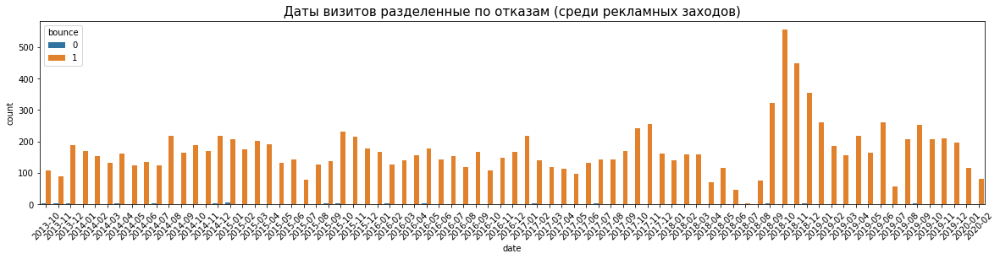

In [121]:
AD_fr = AD1.query('visitDuration == (0)')
plt.figure(figsize=(20, 4))
sns.countplot(x='date', hue='bounce', data=AD_fr)
plt.title('Даты визитов разделенные по отказам (среди рекламных заходов)', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Нулевые заходы очень хорошо распознаются и уходят в отказы.

На всякий случай, посмотрим в рекламных заходах визиты от 1 до 3 секунд.

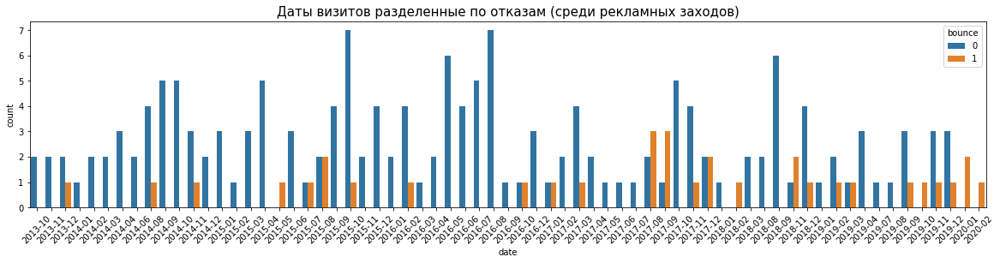

In [122]:
AD_fr_1 = AD1.query('visitDuration == (1, 2, 3)')
plt.figure(figsize=(20, 4))
sns.countplot(x='date', hue='bounce', data=AD_fr_1)
plt.title('Даты визитов разделенные по отказам (среди рекламных заходов)', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Система пропускает, но количество таких визитов незначительно, это могут быть ошибочные заходы (связанные с дублированием торговых марок). В последние два месяца (январь-февраль) пропусков вообще не было.

Посмотрим на нерекламные нулевые заходы.

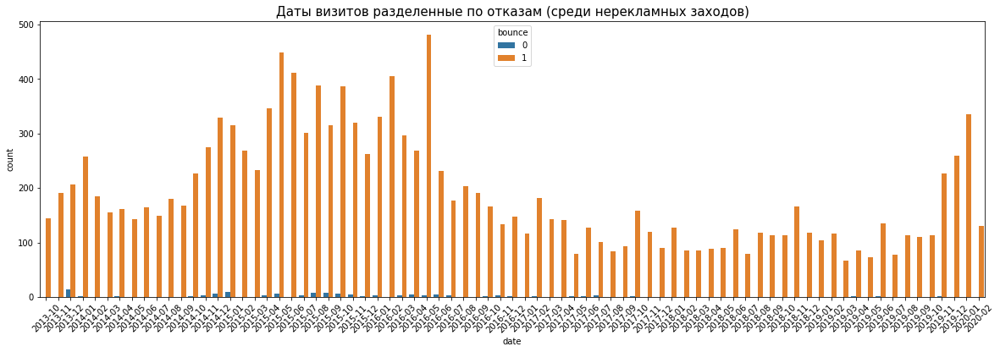

In [123]:
OTH_fr = OTH1.query('visitDuration == (0)')
plt.figure(figsize=(20, 6))
sns.countplot(x='date', hue='bounce', data=OTH_fr)
plt.title('Даты визитов разделенные по отказам (среди нерекламных заходов)', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Система распознавания, в целом, хороша, есть пропуски, но незначительные. Начиная с ноября 2017 система вообще мало пропускает такие клики. Был пик таких заходов с ноября по январь включительно, тогда собственно и были замечены массовые заходы из США.

### 4.3. Сезонность. <a id='104102'></a>

Для заказчика будет предоставлена информация о страницах, на которые чаще всего осуществляется заход из разных источников, типы и конкретные объявления по которым заходили в рамках рекламной кампании, все это можно делить по времени, типам устройств и т.д., но здесь мы эту информацию опустим из соображений конфиденциальности.

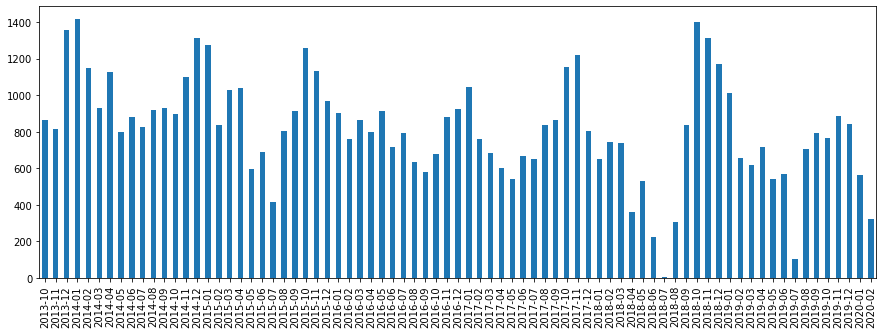

In [124]:
#один из самых интересных признаков, конечно, сезонность:
dat1 = AD1['date'].value_counts().sort_index()
dat1.plot(kind='bar', figsize=(15, 5))

* Присутствует сезонность, в холодное время интерес больше, в связи с особенностями бизнеса (установка автозапуска двигателя в холодное время года становится более востребована) и, возможно, связь с праздниками. В 2013-2014-2016 году пики это декабрь-январь, но в 2015-2017-2018 тренд меняется - это октябрь-ноябрь.
* Есть естественная взаимосвязь с ежегодными пиками просмотров по данной тематике в wordstat, с началом в сентябре и спадом в феврале, они собственно здесь и присутствуют, косвенная связь с погодой присутствует.
* Есть экономическая взаимосвязь в 2018-м летом произошел рост курса доллара - это так же заметно на графике, но и резкий рост заходов потом, тоже объясним, видимо, желание вложить деньги в материальный актив, повлияло на рост продаж автомобилей, соответственно и потребности в установке охранных систем так же возросли.

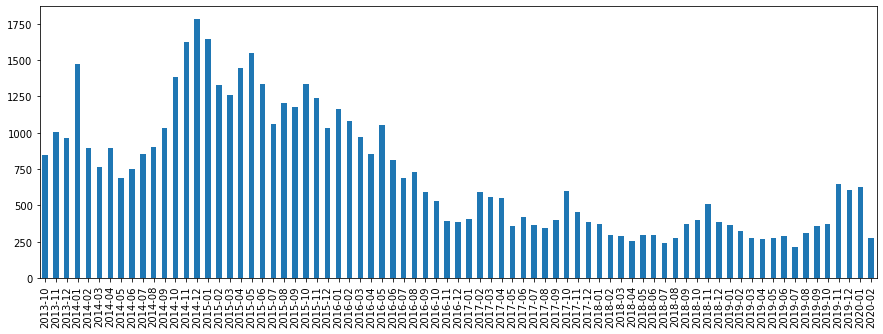

In [125]:
#сравним с нерекламными переходами:
dat001 = OTH1['date'].value_counts().sort_index()
dat001.plot(kind='bar', figsize=(15, 5))

Графики довольно сильно отличаются. Начиная с ноября 2016 года произошло резкое снижение заходов на сайт. Необходимо уточнение причин (предположение, что что-то изменилось в продвижении - статьи, изменения на сайте и т.д.)

### 4.4. Распределение отказов во времени, в зависимости от типа визитов. <a id='104103'></a>

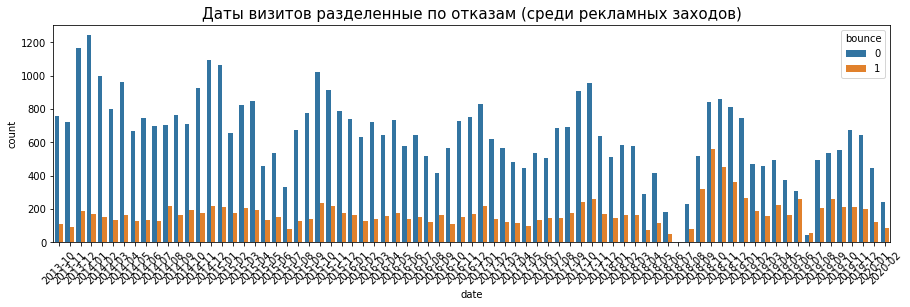

In [126]:
plt.figure(figsize=(15, 4))
sns.countplot(x='date', hue='bounce', data=AD1)
plt.title('Даты визитов разделенные по отказам (среди рекламных заходов)', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Осень 2018 стала лидером по отказам среди рекламных визитов. Необязательно это может быть плохим показателем, возможно, совершенствование Яндексом алгоритмов выявления нулевых кликов, привело к улучшению данного показателя, но скорее всего, это потребует выявления у заказчика, того какие глобальные изменения с сайтом или рекламной кампанией могли быть в июле-августе 2018 года.

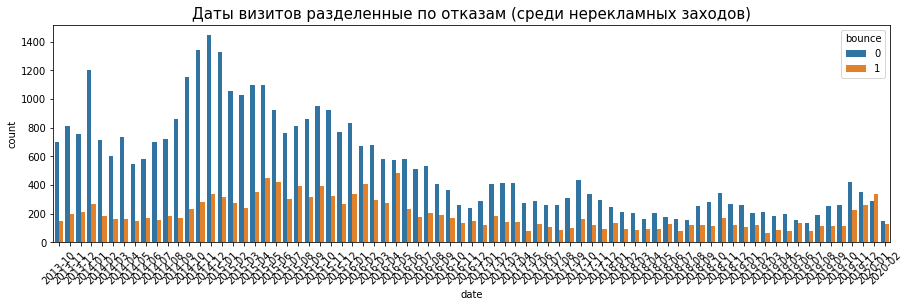

In [127]:
plt.figure(figsize=(15, 4))
sns.countplot(x='date', hue='bounce', data=OTH1)
plt.title('Даты визитов разделенные по отказам (среди нерекламных заходов)', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Начиная с ноября 2019 наметился очень плохой тренд - отказы превышают обычные визиты.

### 4.5. Типы  соединения в зависимости от типа визитов. <a id='104104'></a>

In [128]:
nt = AD1['networkType'].value_counts()
name_nt = ['Неизвестный', '3G-4G', 'Wi-Fi', 'Другие', 'Ethernet', 'Bluetooth']

fig3 = go.Figure(data=[go.Pie(labels=name_nt, values=nt)])
fig3.update_layout(title_text='Типы соединения рекламных визитов.')
#fig3.write_image('tron2.jpeg')
fig3.show()

In [129]:
nt1 = OTH['networkType'].value_counts()

fig4 = go.Figure(data=[go.Pie(labels=name_nt, values=nt1)])
fig4.update_layout(title_text='Типы соединения нерекламных визитов.')
#fig4.write_image('tron3.jpeg')
fig4.show()

Распределения похожи и там и там преобладает неизвестный тип сетей.

### 4.6. Типы  соединения  по датам, в зависимости от типа визитов. <a id='104105'></a>

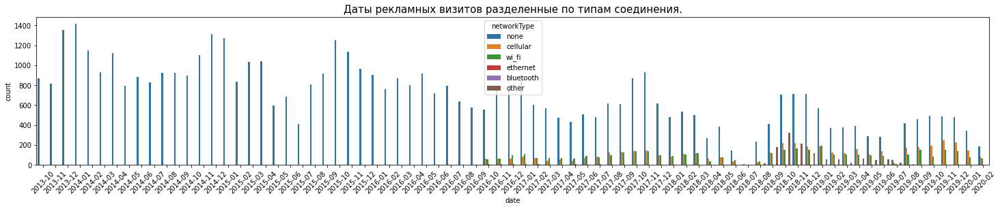

In [130]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='networkType', data=AD1)
plt.title('Даты рекламных визитов разделенные по типам соединения.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

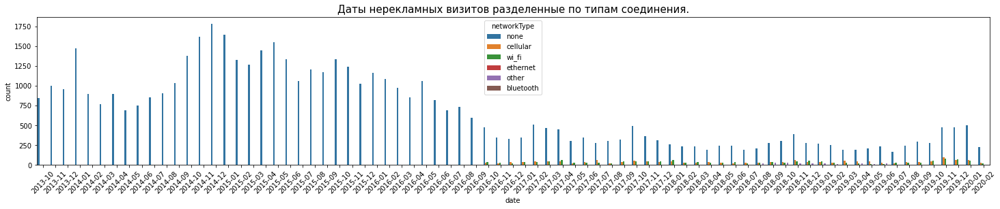

In [131]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='networkType', data=OTH1)
plt.title('Даты нерекламных визитов разделенные по типам соединения.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

**Можно заметить, что разделение типов сетей в Я.Директе произошло начиная с октября 2016 года. Посмотрим на срез с разделениями подробнее.**

In [132]:
AD_ty = AD1.query('date > "2016-09"')
OTH_ty = OTH1.query('date > "2016-09"')

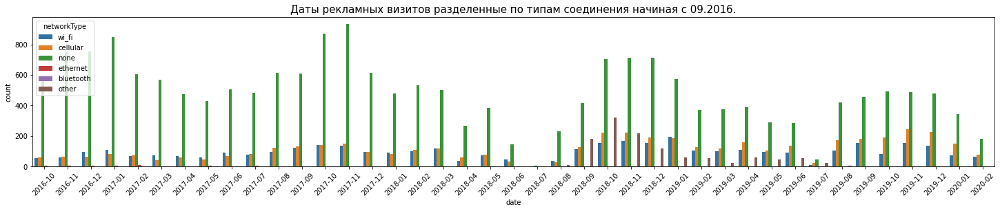

In [133]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='networkType', data=AD_ty)
plt.title('Даты рекламных визитов разделенные по типам соединения начиная с 09.2016.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

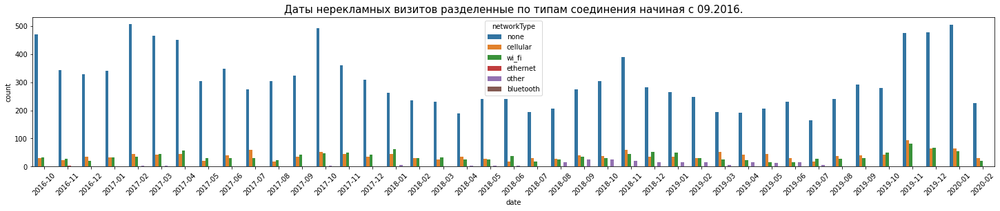

In [134]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='networkType', data=OTH_ty)
plt.title('Даты нерекламных визитов разделенные по типам соединения начиная с 09.2016.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Есть разница, в визитах по рекламе больше визитов other, в остальном есть схожесть, и видны июльские месяцы (2018-2019), когда реклама была вообще отключена.

**Посмотрим также на распределение типов соединения по отказам в зависимости от типа визитов (реклама - не реклама).**

(6.5, -0.5)

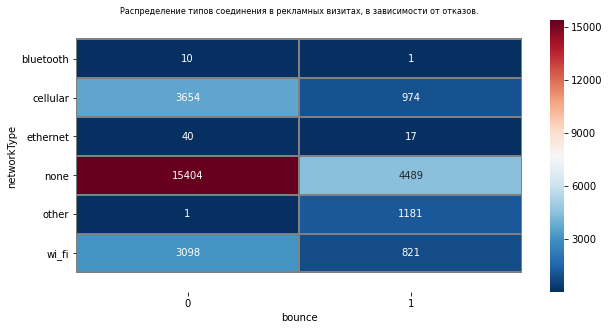

In [135]:
ADnet = AD1.query('date > "2016-09"')
net_rec_bounce = ADnet.pivot_table(index=['networkType'], columns=['bounce'], values='visitID', aggfunc='count')
plt.figure(figsize=(10, 5))
plt.title('Распределение типов соединения в рекламных визитах, в зависимости от отказов.', fontsize=8) 
ax = sns.heatmap(net_rec_bounce, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

(6.5, -0.5)

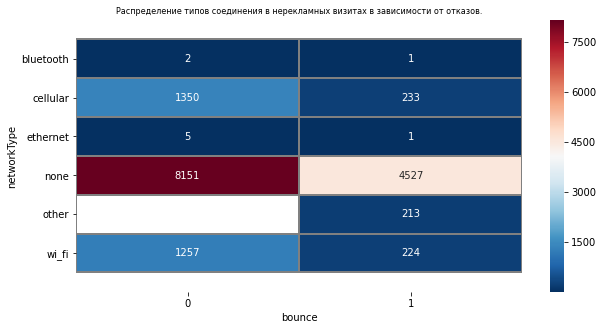

In [136]:
OTHnet = OTH1.query('date > "2016-09"')
net_nonrec_bounce = OTHnet.pivot_table(index=['networkType'], columns=['bounce'], values='visitID', aggfunc='count')
plt.figure(figsize=(10, 5))
plt.title('Распределение типов соединения в нерекламных визитах в зависимости от отказов.', fontsize=8) 
ax = sns.heatmap(net_nonrec_bounce, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

В этот период рекламных визитов больше примерно на 37%, и в обоих случаях, плохо определяется тип сетей - в большинстве случаев тип сети не определен. 
* При близком соотношении отказов, явно видна зависимость - "Другие" сети есть только в отказах (1 визит можно считать случайностью), можно считать это признаком по которому визит попадает в отказ (или система просто не записывает источник, для анализа это не очень хорошо(().
* в нерекламных визитах сетей "wi-fi" меньше в отказах, чем в рекламных.

### 4.7. Типы поисковых систем по типам визитов. <a id='104106'></a>

In [137]:
er = AD1['EngineRoot'].value_counts()
name_er = ['yandex', 'неизвестно', 'mail_ru', 'rambler', 'nigma', 'bing', 'google']

fig5 = go.Figure(data=[go.Pie(labels=name_er, values=er, title='Типы поисковых систем среди рекламных визитов на сайт.')])
fig5.write_image('tron4.jpeg')
fig5.show()

В рекламных визитах преобладает поиск Яндекс (62,8%) и 34,9% не определяется, что скорее всего, тоже Яндекс.

In [138]:
er_n = OTH1['EngineRoot'].value_counts()
name_er_n = ['неизвестно', 'yandex', 'google', 'mail_ru', 'rambler', 'bing', 'nigma', 'yahoo', 'tut_by', 'ask_com', 'duckduckgo', 'poisk_ru', 'qip_search']

fig6 = go.Figure(data=[go.Pie(labels=name_er_n, values=er_n, title='Типы поисковых систем среди нерекламных визитов на сайт.')])
fig6.write_image('tron5.jpeg')
fig6.show()

В нерекламных визитах преобладает поиск Яндекс, но уже меньше - (52%) и 40,3% не определяется, что скорее всего, тоже Яндекс. Разнообразие поисковых систем больше.

### 4.8. Типы поисковых систем по типам визитов (подробно). <a id='104107'></a>

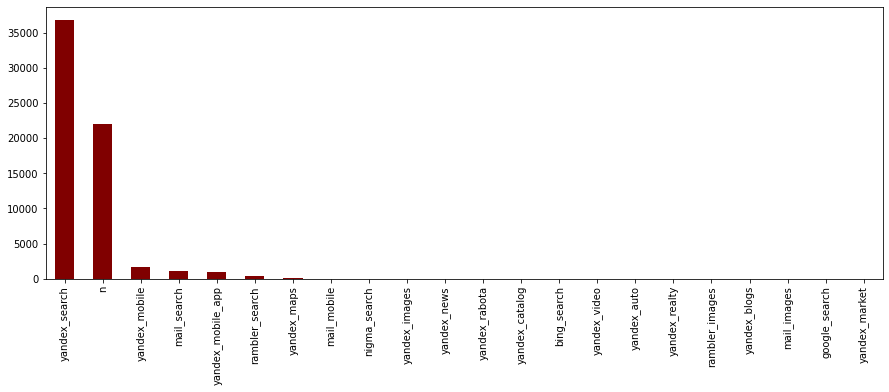

In [139]:
SE = AD1['SearchEngine'].value_counts()
SE.plot(kind='bar', figsize=(15, 5), color=['maroon'])

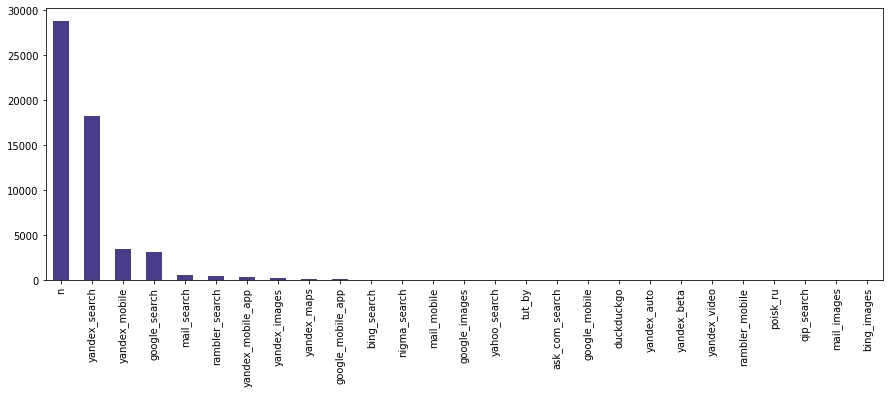

In [140]:
SE1 = OTH1['SearchEngine'].value_counts()
SE1.plot(kind='bar', figsize=(15, 5), color=['DarkSlateBlue'])

Видно различие, в обычных визитах преобладают неизвестные поисковики, с точностью до наоборот.

### 4.9. Типы  операционных систем по типам визитов. <a id='104108'></a>

In [141]:
OSR = AD1['operatingSystemRoot'].value_counts()
name_OSR = ['windows', 'android', 'ios_double', 'не определено', 'macos', 'gnu_linux', 'symbianos', 'java_me', 'blackberry', 'series40', 'tizen', 'sunos', 'google_chrome_os']

fig7 = go.Figure(data=[go.Pie(labels=name_OSR, values=OSR, title='Типы операционных систем среди рекламных визитов на сайт.')])
fig7.write_image('tron6.jpeg')
fig7.show()

Среди визитов по рекламе преобладают: Windows (58,4%), Android (20,7%), IOS_double (15,4%).

In [142]:
OSR_n = OTH1['operatingSystemRoot'].value_counts()
OSR_n
name_OSR_n = ['windows', 'android', 'ios_double', 'не определено', 'macos', 'gnu_linux', 'java_me', 'symbianos', 'blackberry', 'series40', 'bada_os', 'tizen', 'google_chrome_os']

fig8 = go.Figure(data=[go.Pie(labels=name_OSR_n, values=OSR_n, title='Типы операционных систем среди нерекламных визитов на сайт.')])
fig8.write_image('tron7.jpeg')
fig8.show()

Среди нерекламных визитов доля Windows выше - 62,3%, а Android и IOS_double ниже - 14,5% и 12,7% соответственно.

### 4.10. Браузеры по типам визитов. <a id='104109'></a>

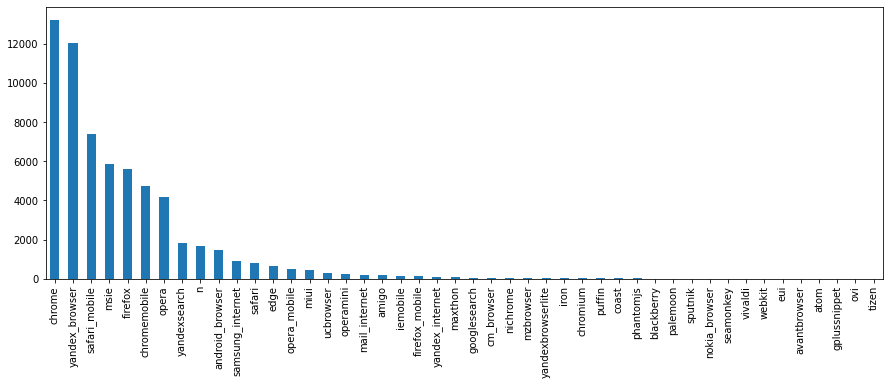

In [143]:
OS = AD1['browser'].value_counts()
OS.plot(kind='bar', figsize=(15, 5))

Лидируют Chrome и Yandex среди рекламных заходов.

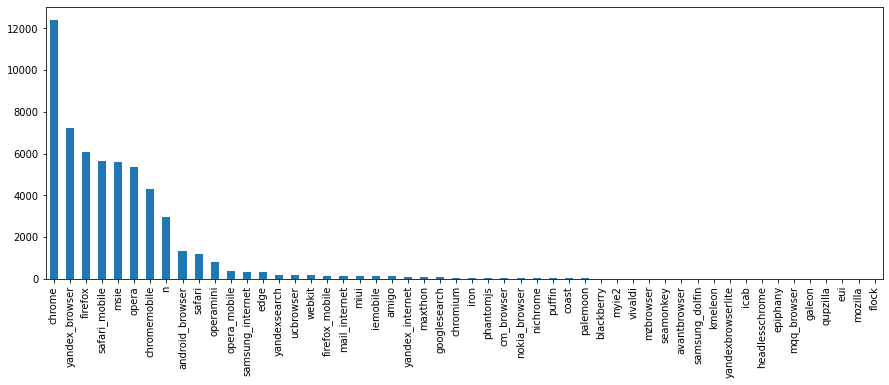

In [144]:
OS_o = OTH1['browser'].value_counts()
OS_o.plot(kind='bar', figsize=(15, 5))

Среди нерекламных лидер Chrome и количество браузеров больше.

******************************
Посмотрим те же данные с разделением по отказам:

(46.5, -0.5)

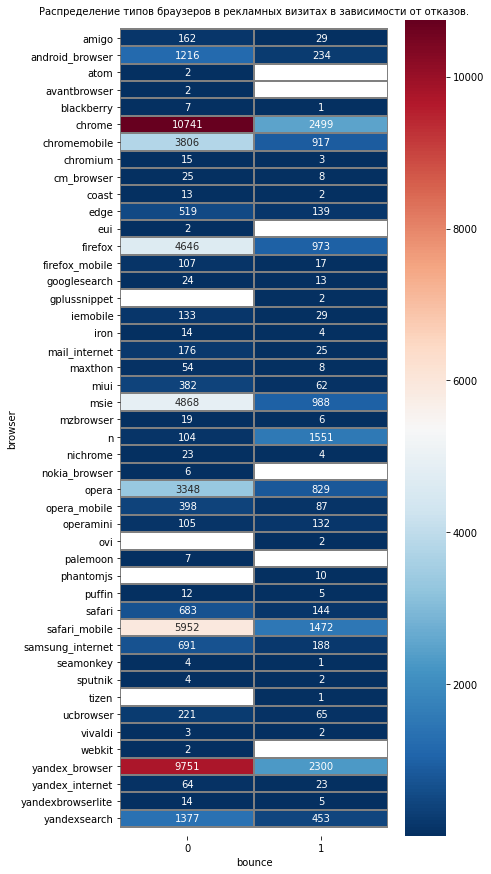

In [145]:
os1 = AD1.pivot_table(index=['browser'], columns=['bounce'], values='visitID', aggfunc='count')
plt.figure(figsize=(6, 15))
plt.title('Распределение типов браузеров в рекламных визитах в зависимости от отказов.', fontsize=10) 
ax = sns.heatmap(os1, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Можно отметить, что среди нераспознанных браузеров доля отказов очень велика - 1 к 15! Нужно уточнять это следствие или причина.

(36.5, -0.5)

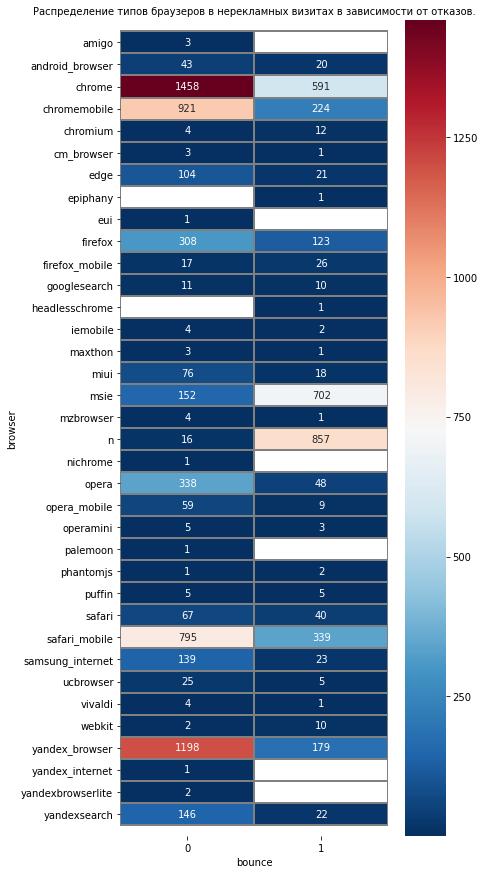

In [146]:
os_n1 = OTH.pivot_table(index=['browser'], columns=['bounce'], values='visitID', aggfunc='count')
plt.figure(figsize=(6, 15))
plt.title('Распределение типов браузеров в нерекламных визитах в зависимости от отказов.', fontsize=10) 
ax = sns.heatmap(os_n1, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Cреди нерекламных визитов - доля отказов в нераспознанных браузерах еще больше чем в рекламных - 1 к 163. Так же выделяется webkit - здесь так же большая доля отказов 1 к 25. Можно сделать вывод, что нераспознанный тип браузера, тоже признак отказного визита.

### 4.11. Виды устройств по типам визитов. <a id='104110'></a>

(4.5, -0.5)

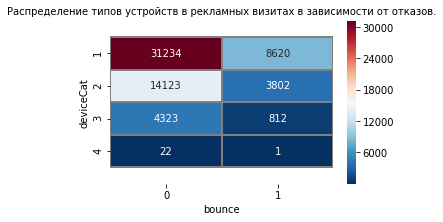

In [147]:
DC = AD1.pivot_table(index=['deviceCat'], columns=['bounce'], values='visitID', aggfunc='count')
plt.figure(figsize=(5, 3))
plt.title('Распределение типов устройств в рекламных визитах в зависимости от отказов.', fontsize=10) 
ax = sns.heatmap(DC, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

(4.5, -0.5)

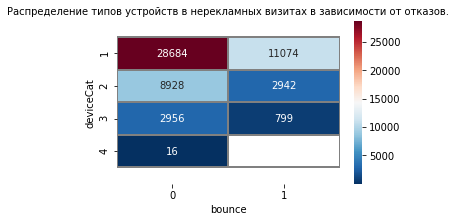

In [148]:
DC_o = OTH1.pivot_table(index=['deviceCat'], columns=['bounce'], values='visitID', aggfunc='count')
plt.figure(figsize=(5, 3))
plt.title('Распределение типов устройств в нерекламных визитах в зависимости от отказов.', fontsize=10) 
ax = sns.heatmap(DC_o, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Из графика видно, что в рекламных визитах с планшетов отказов происходит меньше.

## 5. Исследование для поиска мошеннических действий. <a id='100105'></a>

В последние полгода на сайте наблюдались необычные визиты из США, из двух разных источников. Реклама давалась исключительно в Яндекс.Директе и исключительно на Москву и Подмосковье, поэтому данные визиты сложно объяснить. Большинство этих визитов длились 0 секунд и клики были и по объявлениям Яндекс.Директа. Собственно это и привело к данному анализу данных. Сделать что-то с такими кликами не зная IP пользователя, практически невозможно. Вот и выясним, можно ли извлечь какую-то информацию.

Посмотрим на все IP заходов НЕ из России. 

In [149]:
CO = v.query('Country != "Russia"')

(76.5, -0.5)

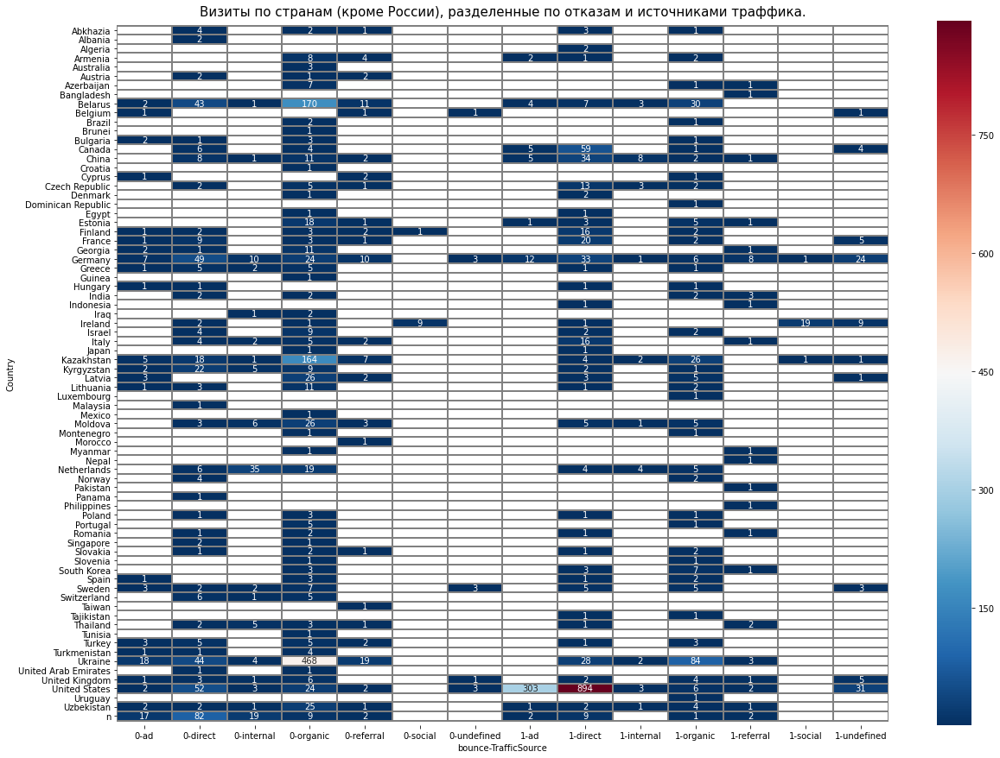

In [150]:
bounce_co = CO.pivot_table(index=['Country'], columns=['bounce', 'TrafficSource'], values='visitID', aggfunc='count')
plt.figure(figsize=(20, 15))
plt.title('Визиты по странам (кроме России), разделенные по отказам и источниками траффика.', fontsize=15) 
ax = sns.heatmap(bounce_co, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

В подтверждение подозрениям, США лидируют в отказах и по рекламе в директе и по прямым заходам. Исследуем все отказы при переходе по рекламным объявлениям, для выяснения возможных скоплений IP.

### 5.1. Скопления IP по времени, среди отказов по типам визитов. <a id='105100'></a>

**Рекламные визиты.**

In [151]:
AD_1 = AD1.query('bounce == 1')
IP_s = AD_1.pivot_table(index=['IP'], columns=['t'], values='visitID', aggfunc='count')
plt.figure(figsize=(30, 880))
plt.title('Скопления IP по времени, среди отказов в рекламных визитах.', fontsize=15) 
ax = sns.heatmap(IP_s, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

(5874.5, -0.5)

Выделяются некоторые скопления IP, но особенно выделяется адрес 66.249.89.xxx, да еще и работает круглосуточно - теперь Яндекс не дает доступа к полным IP, будем исследовать данные скопления на сторонних ресурсах.

**Нерекламные визиты.**

Ищем скопления IP по времени, среди отказов в нерекламных визитах. Такие скопления IP так же могут быть свидетельством попыток понижения позиции сайта в выдаче.

In [152]:
OTH_1 = OTH1.query('bounce == 1')
IP_s_o = OTH_1.pivot_table(index=['IP'], columns=['t'], values='visitID', aggfunc='count')
plt.figure(figsize=(25, 880))
plt.title('Скопления IP по времени, среди отказов в нерекламных визитах.', fontsize=15) 
ax = sns.heatmap(IP_s_o, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

(6328.5, -0.5)

Особенно выделяются круглосуточно работающие 2а02.608:0:1a33.xxx c достаточно большим количеством заходов, ///

### 5.2. Скопления IP из США по типам визитов и отказам. <a id='105101'></a>

(229.5, -0.5)

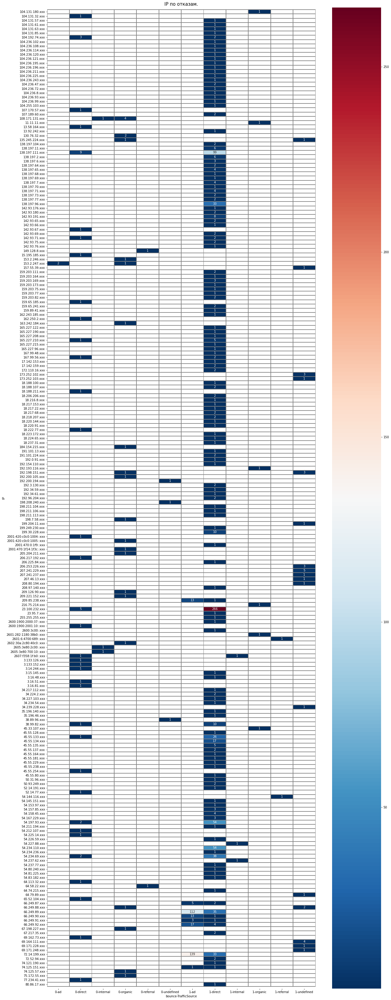

In [153]:
USA = v.query('Country == "United States"')
IP_usa = USA.pivot_table(index=['IP'], columns=['bounce', 'TrafficSource'], values='visitID', aggfunc='count')
plt.figure(figsize=(20, 60))
plt.title('IP по отказам.', fontsize=15) 
ax = sns.heatmap(IP_usa, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Скорее всего вот они наши IP (66.249.89.xxx и 72.14.199.xxx), с которого приходят нулевые визиты в Я.Директ из США, но есть также IP с многократными отказами в прямых заходах - 23.100.232.xxx

Посмотрим так же, в каких временнЫх зонах скопления наших "американских" IP находятся. https://ru.wikipedia.org/wiki/%D0%92%D1%80%D0%B5%D0%BC%D1%8F_%D0%B2_%D0%A1%D0%A8%D0%90 по данным Википедии временные зоны США находятся в пределах с -10 до -5UTC, так же есть зоны -11, -4, +10, -12 и +12. В наших данных это соответсвует: -600, -540, -480, -420, -360, -300, -240, -660, -720, 720, 600.

(1.5, -0.5)

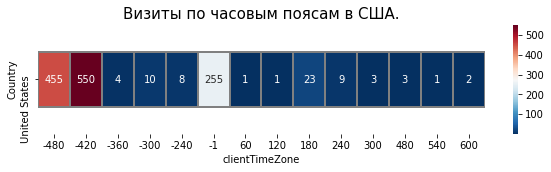

In [154]:
tz_usa = USA.pivot_table(index=['Country'], columns=['clientTimeZone'], values='visitID', aggfunc='count')
plt.figure(figsize=(10, 2))
plt.title('Визиты по часовым поясам в США.', fontsize=15) 
ax = sns.heatmap(tz_usa, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Есть отклонения.

## 6. Исследование подозрительных IP. <a id='100106'></a>

### 6.1. IP 66.249.89.xxx. <a id='106100'></a>

In [155]:
#client_666 = v.query('IP == ("66.249.87.xxx", "66.249.88.xxx", "66.249.89.xxx", "66.249.90.xxx", "66.249.91.xxx", "66.249.92.xxx")')
client_666 = v.query('IP == ("66.249.89.xxx")')
#client_666

In [156]:
client_666.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,1.173000e+03,1173,1173,1173.000000,1173.000000,1173.000000,1173,1173,1173,1.173000e+03,1173,1173,1173,1173,1173,1173,1173,1173,1173,1173,1173,1173,1.173000e+03,1173.000000,1173.0,1173,1173,1173,1173,1173,1173,1173.0,1173.0,1173.0,1173.0,1173.0,1173.0,1173.0,1173.0,1173,1173.0,1173,1173
unique,NaN,1168,10,NaN,NaN,NaN,1,2,4,NaN,2,2,2,1,1,1,1,3,3,3,2,2,NaN,NaN,2.0,2,2,2,2,1,2,NaN,2.0,1.0,2.0,2.0,2.0,2.0,2.0,15,7.0,756,24
top,NaN,2019-01-29 08:11:29,http://dopservis.ru/uslugi/pandora/,NaN,NaN,NaN,66.249.89.xxx,Russia,n,NaN,other,ad,ya_undefined,n,n,n,n,n,0,n,n,n,NaN,NaN,1.0,n,n,n,n,n,Unknown,NaN,28.0,24.0,2.0,1400.0,1024.0,1400.0,1024.0,2018-10,0.0,06-26,с 8 до 9
freq,NaN,2,327,NaN,NaN,NaN,1173,1026,1036,NaN,1116,1018,1169,1173,1173,1173,1173,1169,1169,1169,1169,1169,NaN,NaN,1171.0,1171,1171,1171,1171,1173,1171,NaN,1171.0,1173.0,1171.0,1171.0,1171.0,1171.0,1171.0,325,190.0,5,69
first,NaN,2018-09-14 08:24:54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-01-18 06:47:39,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5.657007e+18,NaN,NaN,1.000853,0.003410,0.999147,NaN,NaN,NaN,1.927713e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.726764e+09,-442.148338,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,3.322326e+18,NaN,NaN,0.029198,0.116791,0.029198,NaN,NaN,NaN,2.386016e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.876383e+08,28.966648,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.669272e+16,NaN,NaN,1.000000,0.000000,0.000000,NaN,NaN,NaN,1.558735e+17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-480.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,3.605284e+18,NaN,NaN,1.000000,0.000000,1.000000,NaN,NaN,NaN,1.539594e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-480.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


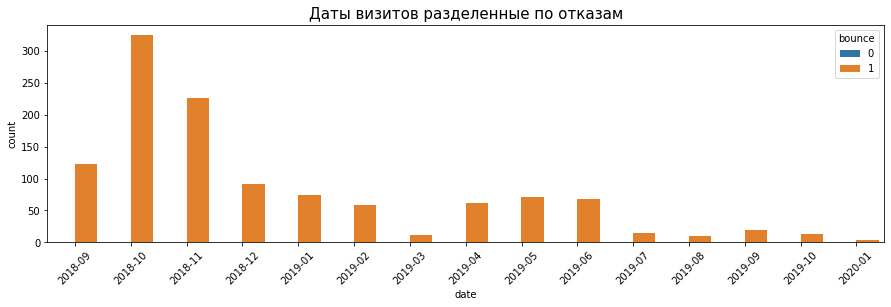

In [157]:
plt.figure(figsize=(15, 4))
sns.countplot(x='date', hue='bounce', data=client_666)
plt.title('Даты визитов разделенные по отказам', fontsize=15)
plt.xticks(rotation=45)
plt.show()

In [158]:
bou_666 = client_666['bounce'].value_counts()
dur_666 = client_666['visitDuration'].value_counts()
nt_666 = client_666['networkType'].value_counts()
bann_666 = client_666['OpenstatAd'].value_counts()
be_666 = client_666['ReferalSource'].value_counts()
TS_666 = client_666['TrafficSource'].value_counts()
ad_666 = client_666['AdvEngine'].value_counts()
er_666 = client_666['EngineRoot'].value_counts()
SE_666 = client_666['SearchEngine'].value_counts()
OSR_666 = client_666['operatingSystemRoot'].value_counts()
OS_666 = client_666['browser'].value_counts()
d_666 = client_666['deviceCat'].value_counts()

In [159]:
print("Отток: ", bou_666, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_666, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_666, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_666, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_666, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_666, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_666, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_666, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_666, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_666, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_666, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_666,  
      sep='')

Отток: 1    1172
0       1
Name: bounce, dtype: int64
_________________________________________________
Время визита в секундах: 0    1172
4       1
Name: visitDuration, dtype: int64
_________________________________________________
Тип соединения: other    1116
none       57
Name: networkType, dtype: int64
_________________________________________________
OpenstatAD: -2147483648    956
 0             155
 443557744      62
Name: OpenstatAd, dtype: int64
_________________________________________________
Переходы с сайтов: n    1173
Name: ReferalSource, dtype: int64
_________________________________________________
Источник трафика: ad        1018
direct     155
Name: TrafficSource, dtype: int64
_________________________________________________
Рекламная система: ya_undefined    1169
ya_direct          4
Name: AdvEngine, dtype: int64
_________________________________________________
Поисковая система: n    1173
Name: EngineRoot, dtype: int64
_____________________________________________

* Подозрительные визиты достаточно хорошо отфильтрованы, всего 1 раз из 1173 пропустили, визит длился 4 секунды, не мешало бы настроить отказы от 4-5 секунд)).
* Большинство посещений по рекламе Яндекса - 86,8%,  прямые заходы - 13,2%.
* По какой-то причине не идентифицируется рекламная система - 99,6%.
* Так же для большинства визитов не известны - браузер, поисковая система, операционная система, переходы с сайтов.
* Все визиты со стационарного компьютера.

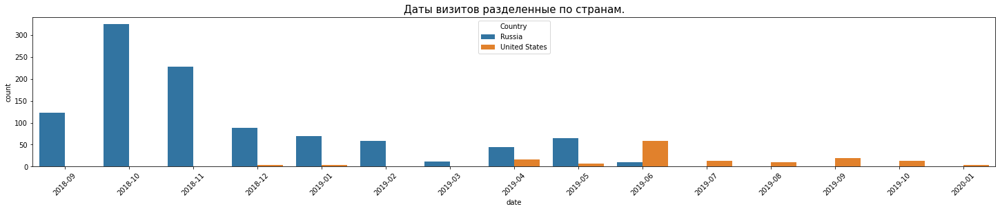

In [160]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='Country', data=client_666)
plt.title('Даты визитов разделенные по странам.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Раньше этот IP числился за Россией, затем шли смешанные данные, с августа 2019 всегда США.

In [161]:
url_666 = client_666['URL'].value_counts()
url_666

http://dopservis.ru/uslugi/pandora/                                                                                                                                                                              327
n                                                                                                                                                                                                                322
http://dopservis.ru/uslugi/pandora/?target_ref=http:%2F%2Ftpc.googlesyndication.com%2Fpagead%2Fimgad%3Fid%3DCKaR7sLA0YH-ywEQwAIYMjIIH4PiWZ6wgJJIBA%26isRtbCreative%3DTrue                                        161
http://dopservis.ru/                                                                                                                                                                                             122
http://dopservis.ru/uslugi/pandora/?target_ref=http:%2F%2Ftpc.googlesyndication.com%2Fpagead%2Fimgad%3Fid%3DCMWvrcv187Hs8AEQwAIY4AMyCJsFtQEfuWe8SAQ%

### 6.2. IP 72.14.199.xxx. <a id='106101'></a>

In [162]:
client_72 = v.query('IP == ("72.14.199.xxx")')

In [163]:
client_72.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,1.810000e+02,181,181,181.0,181.0,181.0,181,181,181,1.810000e+02,181,181,181,181,181,181,181,181,181,181,181,181,1.810000e+02,181.000000,181.0,181,181,181,181,181,181,181.0,181.0,181.0,181.0,181.0,181.0,181.0,181.0,181,181.0,181,181
unique,NaN,181,7,NaN,NaN,NaN,1,3,3,NaN,2,2,1,1,1,1,1,1,1,1,1,1,NaN,NaN,1.0,1,1,1,1,1,1,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,10,7.0,137,21
top,NaN,2019-08-13 00:29:37,http://dopservis.ru/uslugi/pandora/,NaN,NaN,NaN,72.14.199.xxx,United States,Mountain View,NaN,none,ad,ya_undefined,n,n,n,n,n,0,n,n,n,NaN,NaN,1.0,n,n,n,n,n,Unknown,NaN,28.0,24.0,2.0,1400.0,1024.0,1400.0,1024.0,2019-08,3.0,20-41,с 19 до 20
freq,NaN,1,129,NaN,NaN,NaN,181,172,118,NaN,125,148,181,181,181,181,181,181,181,181,181,181,NaN,NaN,181.0,181,181,181,181,181,181,NaN,181.0,181.0,181.0,181.0,181.0,181.0,181.0,53,36.0,3,18
first,NaN,2018-10-05 21:51:54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2019-10-19 19:55:50,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5.196401e+18,NaN,NaN,1.0,0.0,1.0,NaN,NaN,NaN,9.681465e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.741638e+09,-424.309392,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,1.046989e+18,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,7.164946e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.468456e+08,15.534670,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.782158e+18,NaN,NaN,1.0,0.0,1.0,NaN,NaN,NaN,1.564938e+17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-480.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,4.594468e+18,NaN,NaN,1.0,0.0,1.0,NaN,NaN,NaN,1.556557e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-420.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


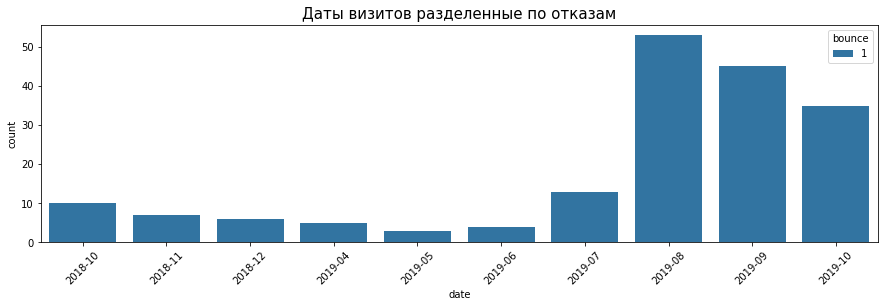

In [164]:
plt.figure(figsize=(15, 4))
sns.countplot(x='date', hue='bounce', data=client_72)
plt.title('Даты визитов разделенные по отказам', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Данный IP действует с октября 2018, но активно начал работать с августа 2019-го. Все визиты попадают в отказ.

In [165]:
bou_72 = client_72['bounce'].value_counts()
dur_72 = client_72['visitDuration'].value_counts()
nt_72 = client_72['networkType'].value_counts()
bann_72 = client_72['OpenstatAd'].value_counts()
be_72 = client_72['ReferalSource'].value_counts()
TS_72 = client_72['TrafficSource'].value_counts()
ad_72 = client_72['AdvEngine'].value_counts()
er_72 = client_72['EngineRoot'].value_counts()
SE_72 = client_72['SearchEngine'].value_counts()
OSR_72 = client_72['operatingSystemRoot'].value_counts()
OS_72 = client_72['browser'].value_counts()
d_72 = client_72['deviceCat'].value_counts()

In [166]:
print("Отток: ", bou_72, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_72, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_72, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_72, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_72, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_72, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_72, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_72, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_72, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_72, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_72, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_72,  
      sep='')

Отток: 1    181
Name: bounce, dtype: int64
_________________________________________________
Время визита в секундах: 0    181
Name: visitDuration, dtype: int64
_________________________________________________
Тип соединения: none     125
other     56
Name: networkType, dtype: int64
_________________________________________________
OpenstatAD: -2147483648    147
 0              33
 443557744       1
Name: OpenstatAd, dtype: int64
_________________________________________________
Переходы с сайтов: n    181
Name: ReferalSource, dtype: int64
_________________________________________________
Источник трафика: ad        148
direct     33
Name: TrafficSource, dtype: int64
_________________________________________________
Рекламная система: ya_undefined    181
Name: AdvEngine, dtype: int64
_________________________________________________
Поисковая система: n    181
Name: EngineRoot, dtype: int64
_________________________________________________
Поисковая система (детально): n    181
Name: 

* Подозрительные визиты отфильтрованы полностью.
* Время во всех визитах нулевое.
* Те же счетчики, что и в предыдущем IP.
* Большинство посещений по рекламе Яндекса - 81,8%,  прямые заходы - 18,2%.
* По какой-то причине не идентифицируется рекламная система.
* Так же для большинства визитов не известны - браузер, поисковая система, операционная система, переходы с сайтов.
* Все визиты со стационарного компьютера.

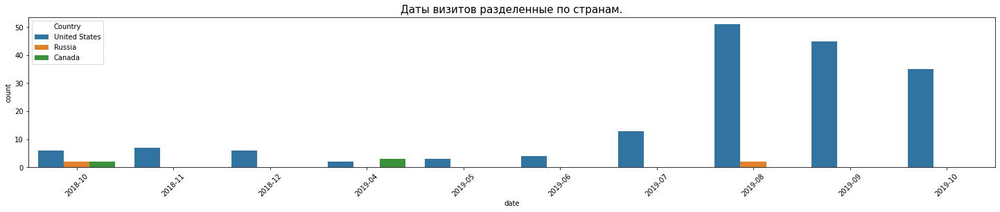

In [167]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='Country', data=client_72)
plt.title('Даты визитов разделенные по странам.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Раньше этот IP определялся как 3 страны (США, Канада, Россия), сейчас чаще всего, как США.

In [168]:
url_72 = client_72['URL'].value_counts()
url_72

http://dopservis.ru/uslugi/pandora/                                                                                                                                                            129
http://dopservis.ru/                                                                                                                                                                            32
n                                                                                                                                                                                                9
http://dopservis.ru/uslugi/pandora/?target_ref=http:%2F%2Ftpc.googlesyndication.com%2Fpagead%2Fimgad%3Fid%3DCKaR7sLA0YH-ywEQwAIYMjIIH4PiWZ6wgJJIBA%26isRtbCreative%3DTrue                        5
http://dopservis.ru/uslugi/pandora/?target_ref=http:%2F%2Ftpc.googlesyndication.com%2Fpagead%2Fimgad%3Fid%3DCMWvrcv187Hs8AEQwAIY4AMyCJsFtQEfuWe8SAQ%26isRtbCreative%3DTrue                       3
http://dopservis.ru/uslug

### 6.3. IP 23.100.232.xxx. <a id='106102'></a>

In [169]:
client_23 = v.query('IP == ("23.100.232.xxx")')

In [170]:
client_23.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,6.580000e+02,658,658,658.000000,658.000000,658.000000,658,658,658,6.580000e+02,658,658,658,658,658,658,658,658,658,658,658,658,658.0,658.000000,658.0,658,658,658,658,658,658,658.0,658.0,658.0,658.0,658.0,658.0,658.0,658.0,658,658.0,658,658
unique,NaN,658,7,NaN,NaN,NaN,1,2,2,NaN,1,1,1,1,1,1,1,1,1,1,1,1,NaN,NaN,1.0,1,1,1,2,1,1,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5,7.0,532,24
top,NaN,2019-12-27 17:55:27,http://dopservis.ru/uslugi/remont_pandora/,NaN,NaN,NaN,23.100.232.xxx,Russia,n,NaN,none,direct,ya_undefined,n,n,n,n,n,0,n,n,n,NaN,NaN,1.0,n,n,windows,windows_7_2008server,msie,Trident,NaN,28.0,24.0,2.0,1024.0,768.0,0.0,0.0,2020-01,3.0,02-12,с 13 до 14
freq,NaN,1,136,NaN,NaN,NaN,658,387,335,NaN,658,658,658,658,658,658,658,658,658,658,658,658,NaN,NaN,658.0,658,658,658,335,658,658,NaN,658.0,658.0,658.0,658.0,658.0,658.0,658.0,251,113.0,4,37
first,NaN,2019-10-12 01:29:24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-02-15 13:54:30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,7.552182e+18,NaN,NaN,1.007599,3.075988,0.990881,NaN,NaN,NaN,2.585940e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,-478.176292,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,6.362314e+18,NaN,NaN,0.086905,49.458625,0.095127,NaN,NaN,NaN,3.928618e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,10.308155,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,9.227137e+15,NaN,NaN,1.000000,0.000000,0.000000,NaN,NaN,NaN,1.577046e+15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,-480.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,5.034963e+17,NaN,NaN,1.000000,0.000000,1.000000,NaN,NaN,NaN,1.574430e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,-480.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


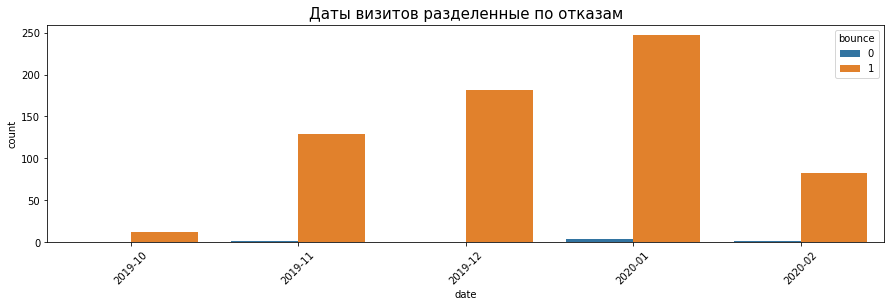

In [171]:
plt.figure(figsize=(15, 4))
sns.countplot(x='date', hue='bounce', data=client_23)
plt.title('Даты визитов разделенные по отказам', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Данный IP действует с октября 2018, но активно начал работать с августа 2019-го. Все визиты попадают в отказ.

In [172]:
bou_23 = client_23['bounce'].value_counts()
dur_23 = client_23['visitDuration'].value_counts()
nt_23 = client_23['networkType'].value_counts()
bann_23 = client_23['OpenstatAd'].value_counts()
be_23 = client_23['ReferalSource'].value_counts()
TS_23 = client_23['TrafficSource'].value_counts()
ad_23 = client_23['AdvEngine'].value_counts()
er_23 = client_23['EngineRoot'].value_counts()
SE_23 = client_23['SearchEngine'].value_counts()
OSR_23 = client_23['operatingSystemRoot'].value_counts()
OS_23 = client_23['browser'].value_counts()
d_23 = client_23['deviceCat'].value_counts()

In [173]:
print("Отток: ", bou_23, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_23, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_23, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_23, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_23, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_23, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_23, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_23, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_23, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_23, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_23, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_23,     
      sep='')

Отток: 1    652
0      6
Name: bounce, dtype: int64
_________________________________________________
Время визита в секундах: 0       651
510       1
282       1
1127      1
46        1
34        1
15        1
10        1
Name: visitDuration, dtype: int64
_________________________________________________
Тип соединения: none    658
Name: networkType, dtype: int64
_________________________________________________
OpenstatAD: 0    658
Name: OpenstatAd, dtype: int64
_________________________________________________
Переходы с сайтов: n    658
Name: ReferalSource, dtype: int64
_________________________________________________
Источник трафика: direct    658
Name: TrafficSource, dtype: int64
_________________________________________________
Рекламная система: ya_undefined    658
Name: AdvEngine, dtype: int64
_________________________________________________
Поисковая система: n    658
Name: EngineRoot, dtype: int64
_________________________________________________
Поисковая система (деталь

* Подозрительные визиты хорошо отфильтрованы.
* Подавляющее большинство визитов нулевое.
* Счетчик 0.
* Все посещения - прямые заходы, но большинство в отказах.
* Так же для большинства визитов не известны - браузер, поисковая система, переходы с сайтов.
* Все визиты со стационарного компьютера и OS Windows.

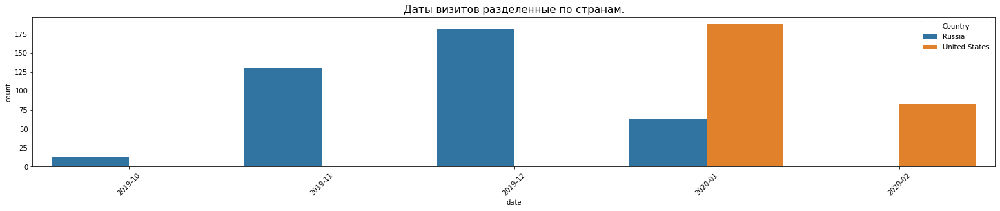

In [174]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='Country', data=client_23)
plt.title('Даты визитов разделенные по странам.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Действует с октября 2019. Раньше этот IP определялся как Россия, сейчас как США.

In [175]:
url_23 = client_23['URL'].value_counts()
url_23

http://dopservis.ru/uslugi/remont_pandora/                                     136
http://dopservis.ru/uslugi/pandora/pandect-1900bt/                             122
http://dopservis.ru/about/                                                      97
http://dopservis.ru/uslugi/pandora/pandect-x-1800-bt/                           80
http://dopservis.ru/uslugi/pandora/avtosignalizatsiya-pandora-dxl-5000-new/     76
http://dopservis.ru/uslugi/pandora/pandora-dx-6x/                               75
http://dopservis.ru/uslugi/pandora/pandora-dx-9x/                               72
Name: URL, dtype: int64

(5.5, -0.5)

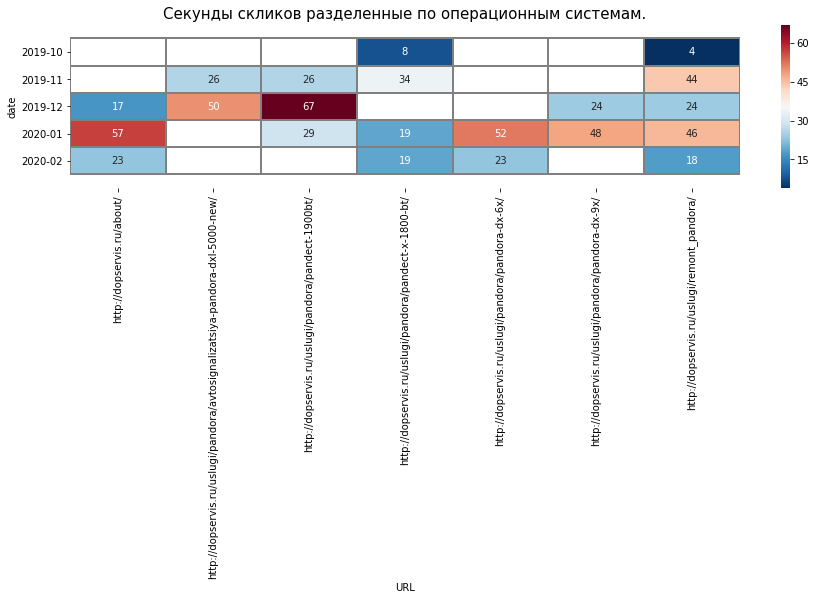

In [176]:
sk_23 = client_23.pivot_table(index=['date'], columns=['URL'], values='visitID', aggfunc='count')
plt.figure(figsize=(15, 3))
plt.title('Секунды скликов разделенные по операционным системам.', fontsize=15) 
ax = sns.heatmap(sk_23, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

### 6.4. IP 83.220.238.xxx. <a id='106103'></a>

In [177]:
client_83 = v.query('IP == ("83.220.238.xxx")')

In [178]:
client_83.describe(include = "all")

,visitID,dateTime,URL,pageViews,visitDuration,bounce,IP,Country,City,clientID,networkType,TrafficSource,AdvEngine,ReferalSource,EngineRoot,SearchEngine,referer,ClickBannGroup,DirectClickBann,DirectPhraseOrCond,DirectPlType,DirectType,OpenstatAd,clientTimeZone,deviceCat,mobilePhone,mobileModel,operatingSystemRoot,operatingSystem,browser,browserEngine,Cookie,screenFormat,screenColor,screenOrient,screenWidth,screenHeight,physScreenWidth,physScreenHeight,date,day,time,t
count,9.940000e+02,994,994,994.000000,994.000000,994.000000,994,994,994,9.940000e+02,994,994,994,994,994,994,994,994,994,994,994,994,9.940000e+02,994.000000,994.0,994,994,994,994,994,994,994.000000,994.0,994.0,994.0,994.0,994.0,994.0,994.0,994,994.0,994,994
unique,NaN,994,82,NaN,NaN,NaN,1,1,8,NaN,4,6,3,62,7,11,11,40,53,156,3,77,NaN,NaN,3.0,32,226,9,49,23,6,NaN,21.0,4.0,3.0,59.0,81.0,46.0,71.0,77,7.0,665,24
top,NaN,2016-08-14 11:08:34,n,NaN,NaN,NaN,83.220.238.xxx,Russia,Moscow,NaN,none,ad,ya_direct,n,yandex,n,n,n,0,n,n,n,NaN,NaN,2.0,apple,iPhone,android,android_lollipop5,safari_mobile,WebKit,NaN,11.0,32.0,1.0,360.0,640.0,1080.0,1920.0,2015-12,0.0,18-56,с 17 до 18
freq,NaN,1,328,NaN,NaN,NaN,994,994,984,NaN,713,622,571,314,511,452,969,443,428,475,475,475,NaN,NaN,753.0,343,297,487,94,262,867,NaN,588.0,699.0,734.0,313.0,265.0,191.0,146.0,30,164.0,7,74
first,NaN,2013-10-12 14:02:42,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2020-02-14 23:14:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,4.962852e+18,NaN,NaN,1.706237,104.224346,0.191147,NaN,NaN,NaN,1.530318e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.681514e+08,191.583501,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.996982,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,2.860640e+18,NaN,NaN,1.813073,340.016016,0.393402,NaN,NaN,NaN,2.865371e+18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.059099e+09,47.622145,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.054882,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.623328e+16,NaN,NaN,1.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.147484e+09,-180.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,3.044299e+18,NaN,NaN,1.000000,15.000000,0.000000,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000e+00,180.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


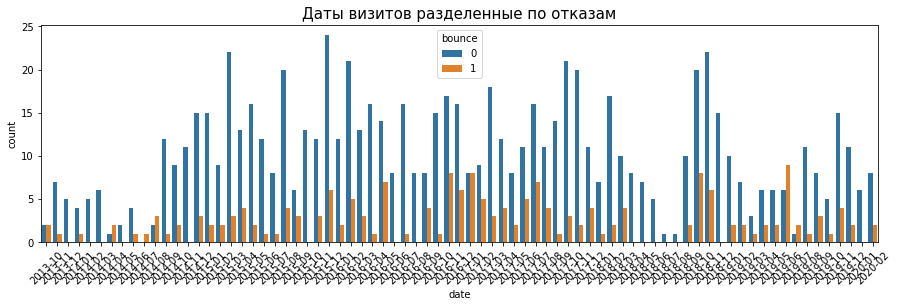

In [179]:
plt.figure(figsize=(15, 4))
sns.countplot(x='date', hue='bounce', data=client_83)
plt.title('Даты визитов разделенные по отказам', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Данный IP действует с октября 2018, но активно начал работать с августа 2019-го. Все визиты попадают в отказ.

In [180]:
bou_83 = client_83['bounce'].value_counts()
dur_83 = client_83['visitDuration'].value_counts()
nt_83 = client_83['networkType'].value_counts()
bann_83 = client_83['OpenstatAd'].value_counts()
be_83 = client_83['ReferalSource'].value_counts()
TS_83 = client_83['TrafficSource'].value_counts()
ad_83 = client_83['AdvEngine'].value_counts()
er_83 = client_83['EngineRoot'].value_counts()
SE_83 = client_83['SearchEngine'].value_counts()
OSR_83 = client_83['operatingSystemRoot'].value_counts()
OS_83 = client_83['browser'].value_counts()
d_83 = client_83['deviceCat'].value_counts()

In [181]:
print("Отток: ", bou_83, '\n',
      "_________________________________________________", '\n',
      "Время визита в секундах: ", dur_83, '\n',
      "_________________________________________________", '\n',
      "Тип соединения: ", nt_83, '\n',
      "_________________________________________________", '\n',
      "OpenstatAD: ", bann_83, '\n',
      "_________________________________________________", '\n',
      "Переходы с сайтов: ", be_83, '\n',
      "_________________________________________________", '\n',
      "Источник трафика: ", TS_83, '\n',
      "_________________________________________________", '\n',
      "Рекламная система: ", ad_83, '\n',
      "_________________________________________________", '\n',
      "Поисковая система: ", er_83, '\n',
      "_________________________________________________", '\n',
      "Поисковая система (детально): ", SE_83, '\n',
      "_________________________________________________", '\n',
      "Группа операционных систем: ", OSR_83, '\n',
      "_________________________________________________", '\n',
      "Браузер: ", OS_83, '\n',
      "_________________________________________________", '\n',
      "Устройство: ", d_83,     
      sep='')

Отток: 0    804
1    190
Name: bounce, dtype: int64
_________________________________________________
Время визита в секундах: 15      262
0       192
16       95
17       24
14       21
18       12
19       11
23       10
28        8
32        7
26        7
29        6
20        6
27        6
57        6
12        5
34        5
22        5
79        5
38        4
50        4
88        4
58        4
63        4
31        4
106       4
21        4
10        4
92        3
40        3
62        3
70        3
9         3
120       3
55        3
6         3
24        3
45        3
42        3
275       3
39        3
112       3
11        3
94        2
132       2
168       2
76        2
121       2
65        2
149       2
80        2
82        2
177       2
244       2
86        2
233       2
102       2
115       2
91        2
184       2
93        2
156       2
206       2
111       2
59        2
35        2
429       2
13        2
30        2
36        2
49        2
48        2
56       

* Подозрительные визиты хорошо отфильтрованы.
* Подавляющее большинство визитов нулевое.
* Счетчик 0.
* Все посещения - прямые заходы, но большинство в отказах.
* Так же для большинства визитов не известны - браузер, поисковая система, переходы с сайтов.
* Все визиты со стационарного компьютера и OS Windows.

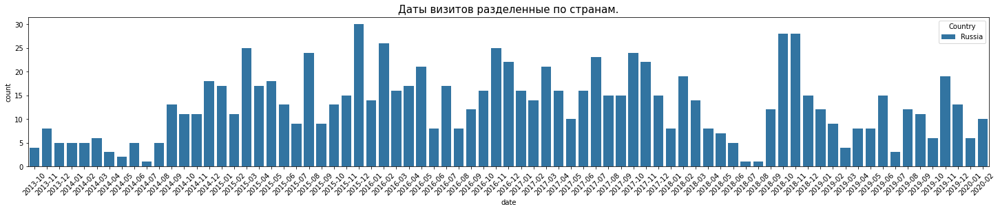

In [182]:
plt.figure(figsize=(25, 4))
sns.countplot(x='date', hue='Country', data=client_83)
plt.title('Даты визитов разделенные по странам.', fontsize=15)
plt.xticks(rotation=45)
plt.show()

Действует с октября 2019. Раньше этот IP определялся как Россия, сейчас как США.

In [183]:
url_83 = client_83['URL'].value_counts()
url_83

n                                                                                                                                          328
http://dopservis.ru/uslugi/pandora/avtosignalizatsiya-pandora-dxl-3910/                                                                    147
http://dopservis.ru/                                                                                                                        98
http://dopservis.ru/index.php/uslugi/secure-over/pandora-all                                                                                75
http://dopservis.ru/uslugi/pandora/                                                                                                         45
http://dopservis.ru/uslugi/pandora/pandora-dx-6x/                                                                                           30
http://dopservis.ru/uslugi/remont_pandora/                                                                                                  23

(82.5, -0.5)

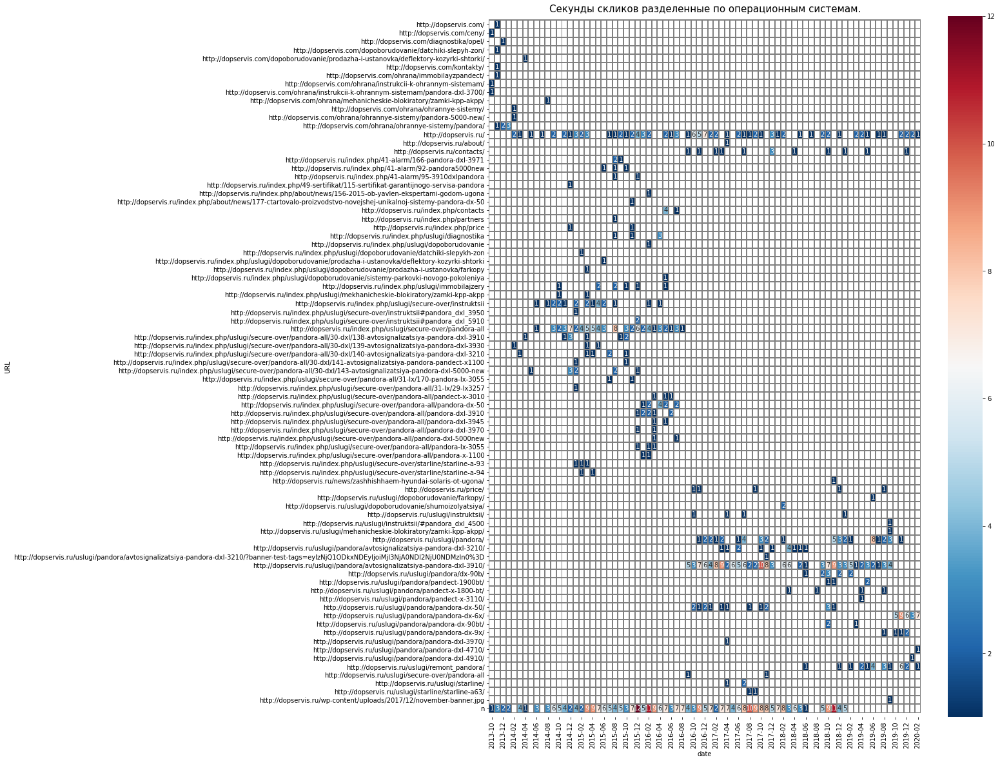

In [184]:
sk_83 = client_83.pivot_table(index=['URL'], columns=['date'], values='visitID', aggfunc='count')
plt.figure(figsize=(15, 20))
plt.title('Секунды скликов разделенные по операционным системам.', fontsize=15) 
ax = sns.heatmap(sk_83, annot=True, fmt='.0f', linewidths=1, linecolor='grey', cmap='RdBu_r')
i, k = ax.get_ylim()
ax.set_ylim(i+0.5, k-0.5)

Исследованы 4 IP на сайте https://cleantalk.org/ru/blacklists/66.249.89.106 https://cleantalk.org/ru/blacklists/23.100.232.233 https://cleantalk.org/ru/blacklists/72.14.199.198  https://cleantalk.org/blacklists/83.220.238.242 - принято решение заблокировать группу адресов  и два точных адреса - 66.249.89.0/19, 23.100.232.233, 72.14.199.198. Улучшить защиту контактной страницы на сайте (WordPress).

## 7. Матрицы корреляции. <a id='100107'></a>

Предобработаем данные для матрицы.

In [185]:
def ref(referer):
    if referer == "n":
        return '0'
    if referer != "n":
        return '1'
v['referer'] = v['referer'].apply(ref)

In [186]:
def bro(brow):
    if brow == "chrome":
        return '1'
    elif brow == "yandex_browser":
        return '2'
    elif brow == "safari_mobile":
        return '3'
    elif brow == "firefox":
        return '4'
    elif brow == "msie":
        return '5'
    elif brow == "opera":
        return '6'
    elif brow == "chromemobile":
        return '7'
    elif brow == "n":
        return '0'
    elif brow == "android_browser":
        return '8'
    elif brow == "yandexsearch":
        return '9'
    elif brow == "safari":
        return '10'
    elif brow == "samsung_internet":
        return '11'
    elif brow == "operamini":
        return '12'
    return '13'
v['browser'] = v['browser'].apply(bro)

In [187]:
def countr(cou):
    if cou == "Russia":
        return '1'
    return '0'
v['Country'] = v['Country'].apply(countr)

In [188]:
df = v[['visitID', 'pageViews', 'visitDuration', 'bounce', 'Country', 'networkType', 'TrafficSource', 
        'EngineRoot', 'referer', 'clientTimeZone', 'deviceCat', 'operatingSystemRoot', 'browser', 'screenFormat', 
        'screenColor', 'screenOrient', 'day']]

In [189]:
df['TrafficSource'] = df['TrafficSource'].replace('undefined', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('referral', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('internal', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('organic', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('messenger', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('recommend', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('social', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('saved', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('direct', '0', regex=True)
df['TrafficSource'] = df['TrafficSource'].replace('ad', '1', regex=True)
df['TrafficSource'] = df['TrafficSource'].astype(int)

In [190]:
df['networkType'] = df['networkType'].replace('cellular', '1', regex=True)
df['networkType'] = df['networkType'].replace('wi_fi', '2', regex=True)
df['networkType'] = df['networkType'].replace('ethernet', '3', regex=True)
df['networkType'] = df['networkType'].replace('other', '4', regex=True)
df['networkType'] = df['networkType'].replace('bluetooth', '5', regex=True)
df['networkType'] = df['networkType'].replace('none', '0', regex=True)
df['networkType'] = df['networkType'].astype(int)

In [191]:
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('android', '1', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('ios_double', '2', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('windows', '3', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('macos', '4', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('gnu_linux', '5', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('tizen', '6', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('google_chrome_os', '7', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('java_me', '8', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('symbianos', '9', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('series40', '10', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('sunos', '11', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('blackberry', '12', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('bada_os', '13', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].replace('n', '0', regex=True)
df['operatingSystemRoot'] = df['operatingSystemRoot'].astype(int)

In [192]:
df['EngineRoot'] = df['EngineRoot'].replace('yandex', '1', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('rambler', '2', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('mail_ru', '3', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('google', '4', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('nigma', '5', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('bing', '6', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('yahoo', '7', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('tut_by', '8', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('ask_com', '9', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('qip_search', '10', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('poisk_ru', '11', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('duckduckgo', '12', regex=True)
df['EngineRoot'] = df['EngineRoot'].replace('n', '0', regex=True)
df['EngineRoot'] = df['EngineRoot'].astype(int)

In [193]:
df['referer'] = df['referer'].astype(int)
df['screenFormat'] = df['screenFormat'].astype(int)
df['screenColor'] = df['screenColor'].astype(int)
df['screenOrient'] = df['screenOrient'].astype(int)
df['deviceCat'] = df['deviceCat'].astype(int)
df['browser'] = df['browser'].astype(int)
df['Country'] = df['Country'].astype(int)
df['day'] = df['day'].astype(int)

In [194]:
#df.info()

In [195]:
#df.tail(20)

### 7.1. Общая матрица корреляции признаков. <a id='107100'></a>

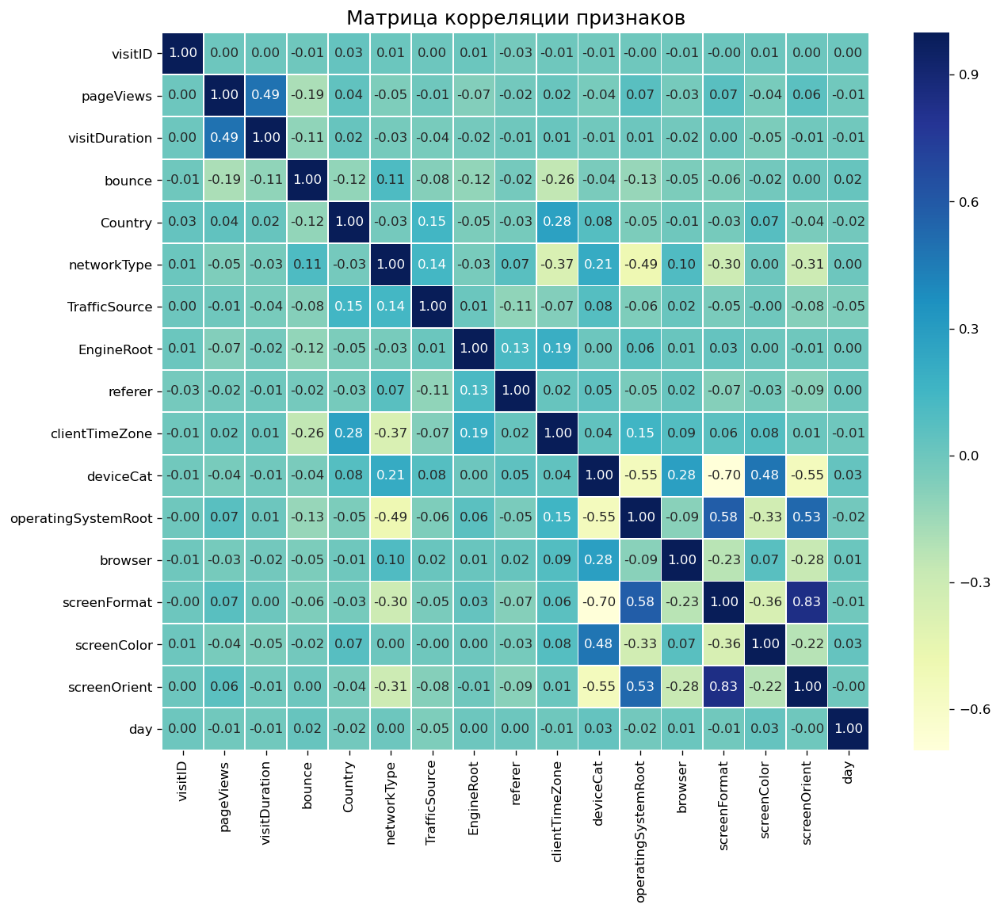

In [196]:
plt.figure(figsize=(12,10), dpi= 120)
plt.title('Матрица корреляции признаков', fontsize=15) 
o1 = df.corr()
ax = sns.heatmap(o1, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Больше всего нас интересуют корреляции в таких признаках, как **отток** (bounce), **источник траффика** (TrafficSource), глубина просмотра (pageViews), время на сайте (visitDuration), страна (Country), тип устройства (deviceCat), браузер (browser), день недели (day).

* Категория день недели не имеет сильных корреляций с другими признаками.
* отток коррелирует только с временными зонами (-0,26) (со странами меньше, но страны могут и не соответствовать временным зонам, как мы уже видели ранее), и глубиной просмотра (0,19).
* источник трафика так же имеет малую корреляцию - со странами (0,15) и типом соединения (0,14).
* глубина просмотра коррелирует с временем на сайте (0,49), но это довольно естественная корреляция.
* страны имеют естественную корреляцию с временнЫми зонами (0,28).
* тип устройства немного (0,21) коррелирует с типом соединения и браузером (0,28), средне с группой операционных систем (-0,55), остальные корреляции естественны (из-за тех.характеристик устройств).

### 7.2. Матрица корреляции признаков разделенных по оттоку. <a id='107101'></a>

In [197]:
bounce = df.query('bounce == 1')
remain = df.query('bounce == 0')

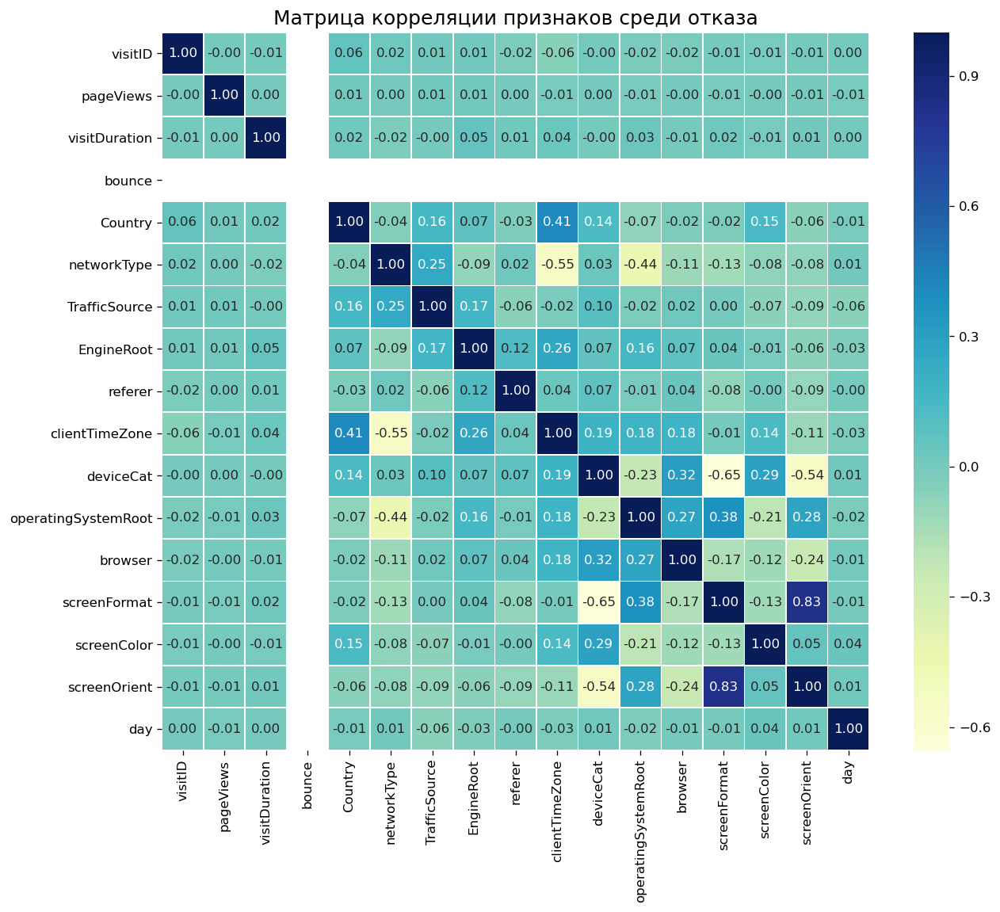

In [198]:
plt.figure(figsize=(12,10), dpi= 120)
plt.title('Матрица корреляции признаков среди отказа', fontsize=15) 
b2 = bounce.corr()
ax = sns.heatmap(b2, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Посмотрим на корреляцию признаков среди отказных визитов:

* Категория день недели не приобрела сильных корреляций с другими признаками.
* источник трафика имеет малую корреляцию (она немного выросла если сравнивать с общими данными) - со странами (0,16) и типом соединения (0,25 (выросла с 0,14)). Так же появилась корреляция с поисковыми системами (0,17).
* глубина просмотра **полностью потеряла корреляцию со временем на сайте (с 0,49 до 0,00??).**
* у стран выросла стественная корреляция с временнЫми зонами (с 0,28 до 0,41) и появилась небольшая корреляция с типом устройства (0,14).
* тип устройства потерял корреляцию (с 0,21 до 0,03) с типом соединения, с браузером немного выросла (с 0,28 до 0,32), упала с группой операционных систем (с -0,55 до -0,23), остальные корреляции естественны (из-за тех.характеристик устройств).
* браузер начал немного коррелировать с ОС (0,27).

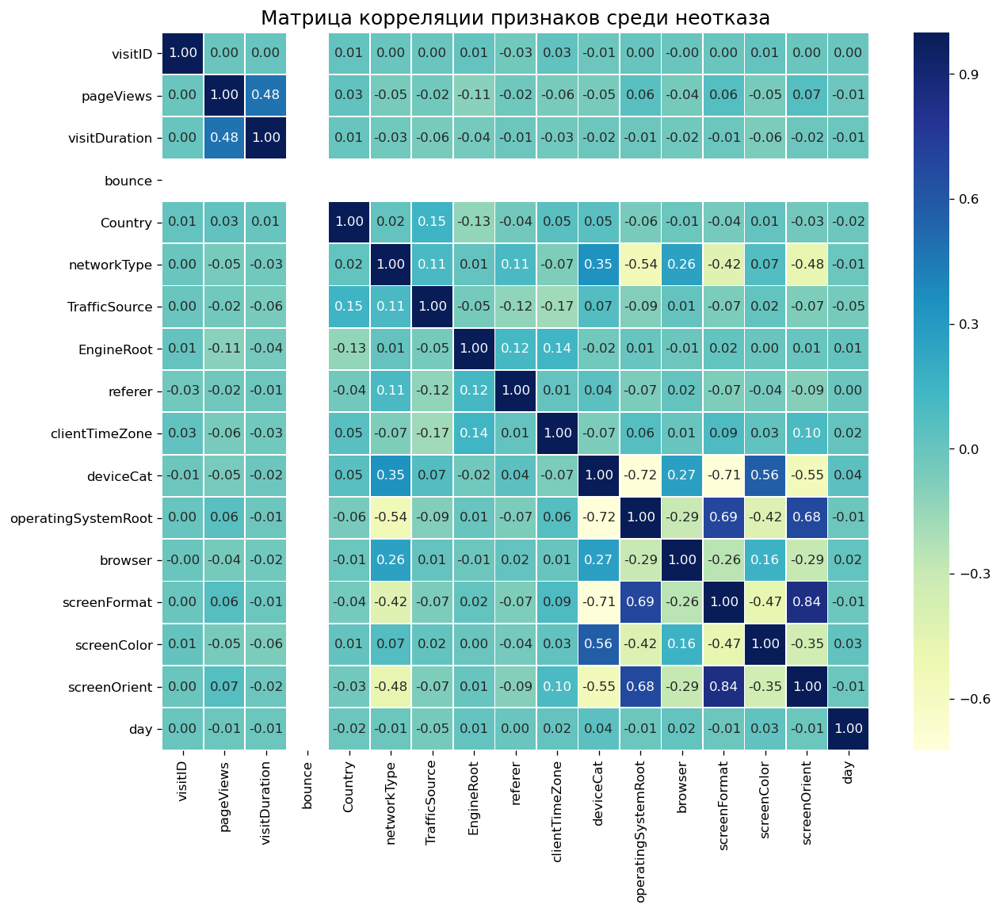

In [199]:
plt.figure(figsize=(12,10), dpi= 120)
plt.title('Матрица корреляции признаков среди неотказа', fontsize=15) 
r1 = remain.corr()
ax = sns.heatmap(r1, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Посмотрим на корреляцию признаков среди отказных визитов:

* Категория день недели не получила сильных корреляций с другими признаками.
* источник трафика так же мало коррелирует - со странами (0,15) и типом соединения (с 0,14 снизилась до 0,11).
* глубина просмотра коррелирует с временем на сайте (0,48), но это довольно естественная корреляция.
* естественная корреляция стран с временнЫми зонами понизилась (с 0,28 до 0,15).
* тип устройства (повысилась с 0,21 до 0,35) коррелирует с типом соединения и браузером (0,27), средне с группой операционных систем (с -0,55 до -0,72), остальные корреляции естественны (из-за тех.характеристик устройств).

Между визитами с отказом и без отказа, есть различия.

* между глубиной просмотра и временем проведенным на сайте есть взаимосвязь только в отказных визитах, а связь межу странами и временнЫми зонами есть только в неотказных визитах.

### 7.3. Матрица корреляции признаков разделенных по рекламе. <a id='107102'></a>

In [200]:
ad_1 = df.query('TrafficSource == 1')
ad_0 = df.query('TrafficSource == 0')

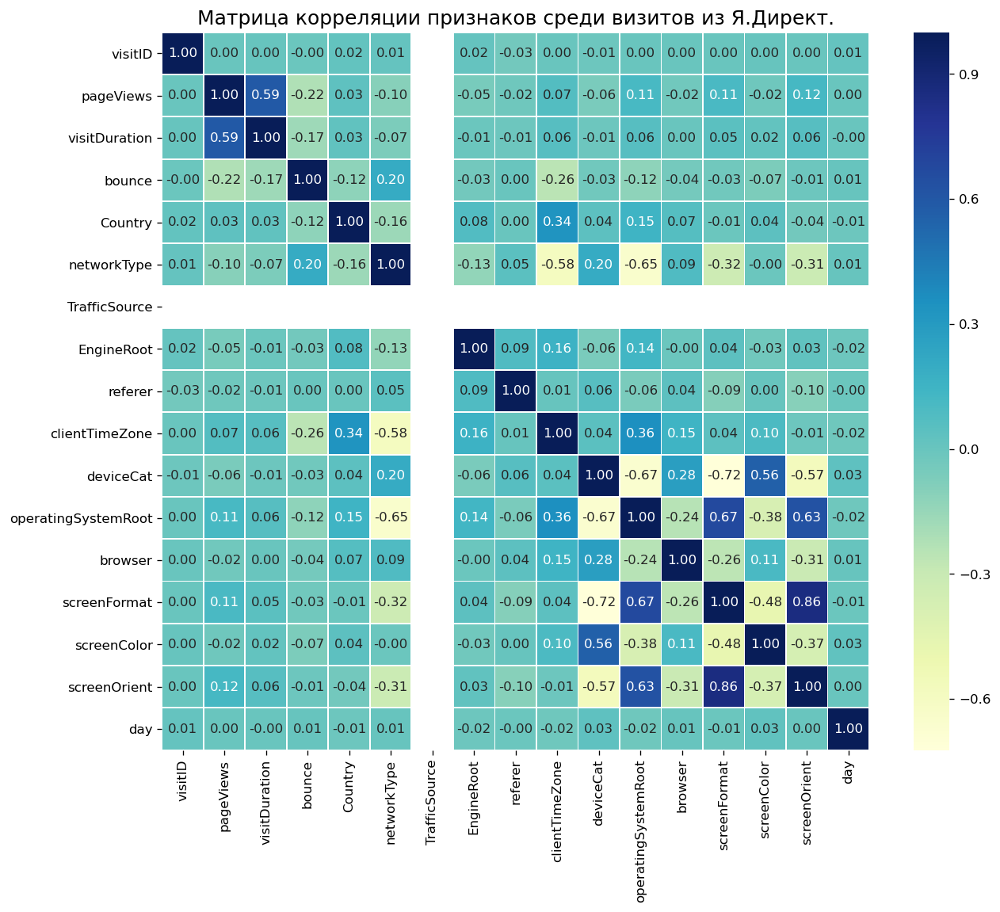

In [201]:
plt.figure(figsize=(12,10), dpi= 120)
plt.title('Матрица корреляции признаков среди визитов из Я.Директ.', fontsize=15) 
b1 = ad_1.corr()
ax = sns.heatmap(b1, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Посмотрим на корреляцию признаков среди визитов по рекламе:

* Категория день недели не имеет сильных корреляций с другими признаками.
* отток коррелирует с глубиной просмотра (-0,22 корреляция поменялась на обратную с 0,19 в общих данных), типом соединения (0,20), временем на сайте (-0,17), с временными зонами (-0,26) (со странами меньше, но страны могут и не соответствовать временным зонам, как мы уже видели ранее).
* глубина просмотра коррелирует с временем на сайте (выросла с 0,49 до 0,59 по сравнению с общими данными), но это довольно естественная корреляция.
* страны имеют естественную корреляцию с временнЫми зонами (выросла с 0,28 до 0,34).
* тип устройства немного (0,20) коррелирует с типом соединения и браузером (0,28), средне с группой операционных систем (выросла с -0,55 до - 0,67 по сравнению с общими данными), остальные корреляции естественны (из-за тех.характеристик устройств).
* появилась корреляция ОС с временными зонами (0,36)

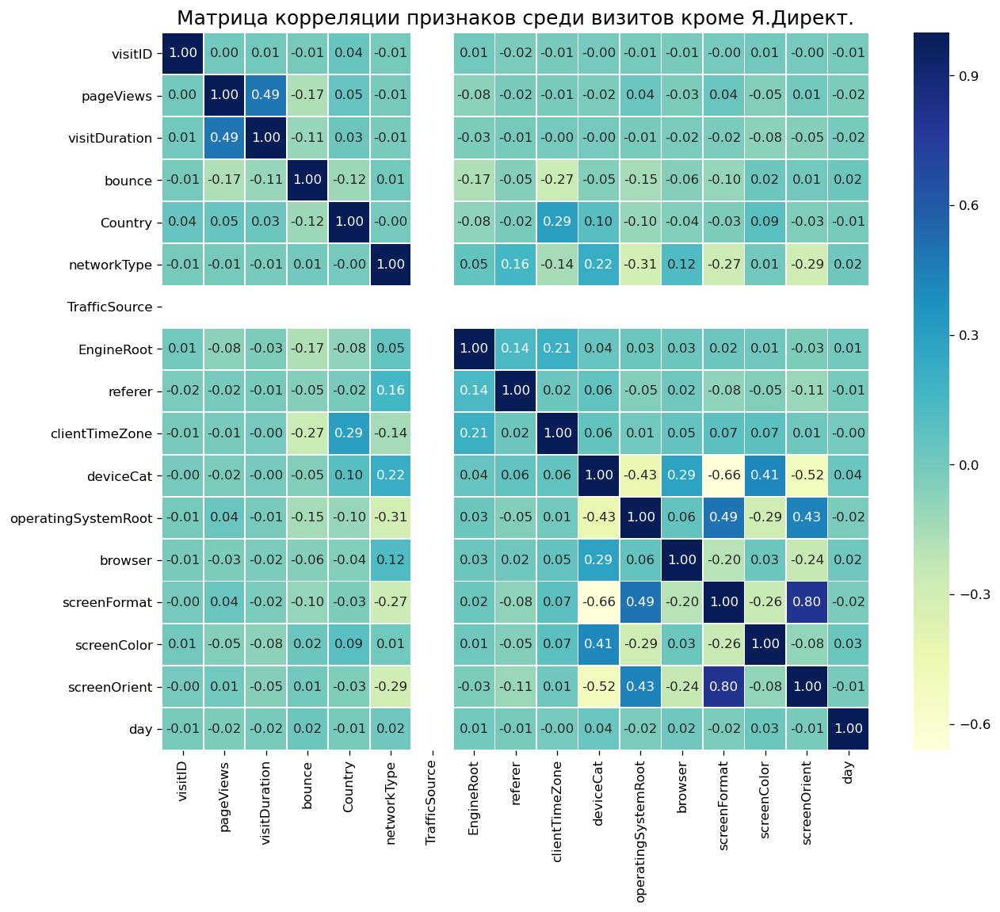

In [202]:
plt.figure(figsize=(12,10), dpi= 120)
plt.title('Матрица корреляции признаков среди визитов кроме Я.Директ.', fontsize=15) 
b3 = ad_0.corr()
ax = sns.heatmap(b3, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Посмотрим на корреляцию признаков среди нерекламных визитов:

* Категория день недели не имеет сильных корреляций с другими признаками.
* отток коррелирует только с временными зонами (-0,27), временем на сайте (-0,11), с временными зонами (-0,27).
* глубина просмотра коррелирует с временем на сайте (0,49), но это довольно естественная корреляция.
* страны имеют естественную корреляцию с временнЫми зонами (0,29).
* тип устройства немного (0,22) коррелирует с типом соединения и браузером (0,29), средне с группой операционных систем (упала с -0,55 до -0,43 по сравнению с общими), остальные корреляции естественны (из-за тех.характеристик устройств).

Отличия разных типов визитов (рекламных и нет):

* у ОС в рекламных визитах есть корреляция с временными зонами (0, 36) у нерекламных визитов ее практически нет (0,01). 
* в нерекламных визитах появилась корреляция переходов по реферальным ссылкам с поисковой системой (0,14) и типом соединения (0,16).

### 7.4. Матрица корреляции признаков разделенных по устройствам. <a id='107103'></a>

In [203]:
df['deviceCat'].value_counts()

1    79612
2    29795
3     8890
4       39
Name: deviceCat, dtype: int64

In [204]:
desktop = df.query('deviceCat == 1')
phone = df.query('deviceCat == 2')
mobcomp = df.query('deviceCat == 3')

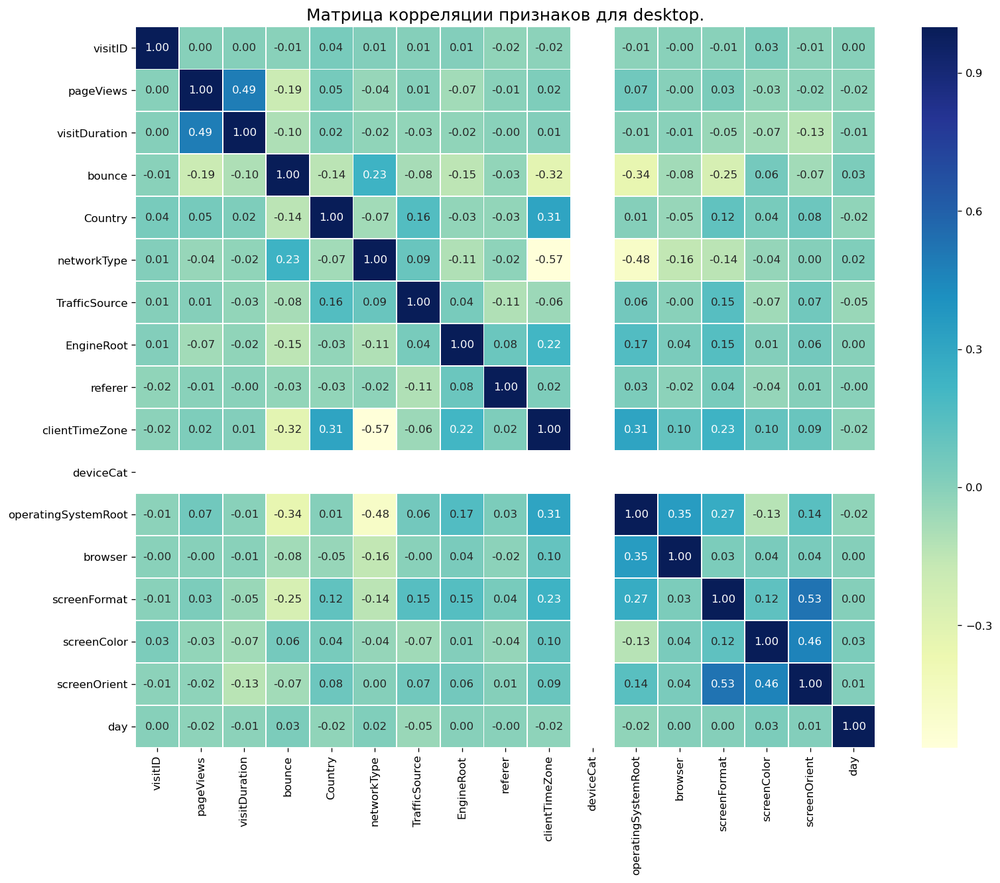

In [205]:
plt.figure(figsize=(15,12), dpi= 120)
plt.title('Матрица корреляции признаков для desktop.', fontsize=15) 
d1 = desktop.corr()
ax = sns.heatmap(d1, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Посмотрим на корреляции признаков среди визитов с ПК:

* Категория день недели не имеет сильных корреляций с другими признаками.
* отток коррелирует только с временными зонами (-0,32), глубиной просмотра (-0,19), типом соединения (0,23), ОС (-0,34), соотношением сторон экрана (-0,25). **Проверить, возможно последние две корреляции, влияют на отток среди ПК!**.
* источник трафика перестал значимо коррелировать.
* страны имеют естественную корреляцию с временнЫми зонами (0,31).
* ОС коррелирует с браузером (0,35) и соотношением сторон экрана (0,27).

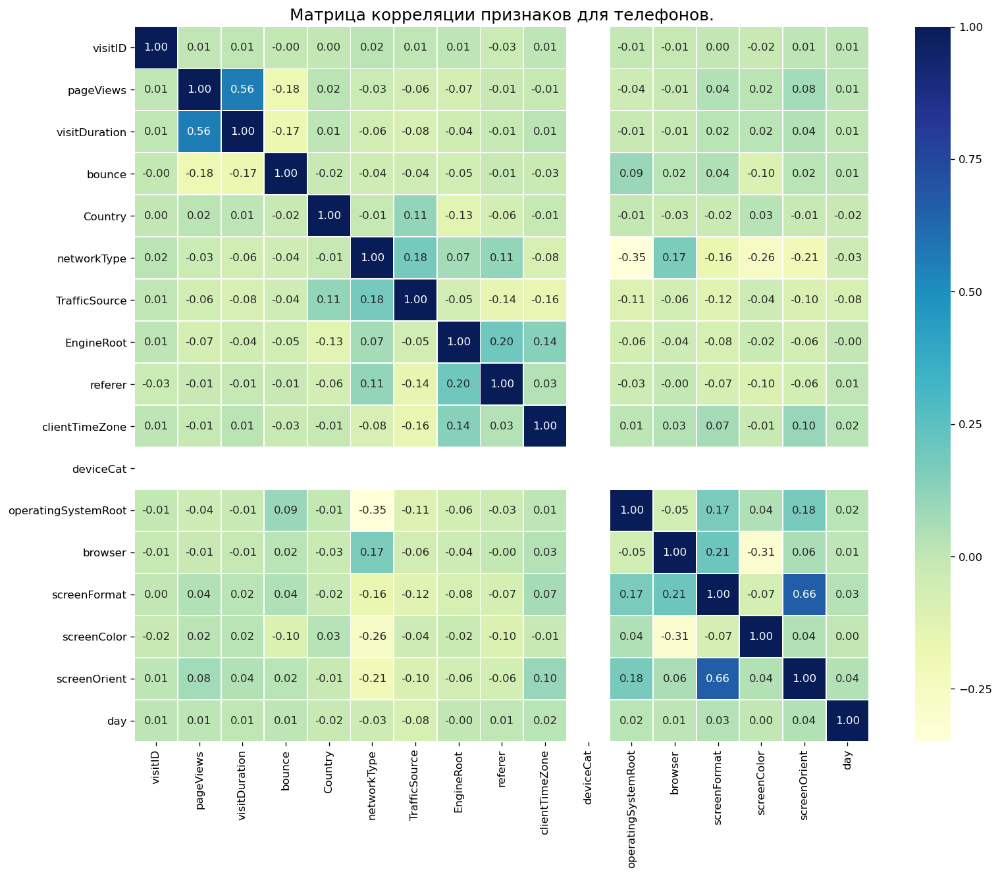

In [206]:
plt.figure(figsize=(15,12), dpi= 120)
plt.title('Матрица корреляции признаков для телефонов.', fontsize=15) 
p1 = phone.corr()
ax = sns.heatmap(p1, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Посмотрим на корреляции признаков среди визитов с телефона:

* Категория день недели не имеет сильных корреляций с другими признаками.
* отток перестает коррелировать с временными зонами (в общих данных было -0,32), с глубиной просмотра (-0,18), со временем на сайте (-0,17).
* источник трафика имеет малую корреляцию с типом соединения (0,18), с временнЫми зонами (-0,16).
* страны имеют естественную корреляцию с временнЫми зонами (0,31).
* появилась корреляция типа соединения с ОС (-0,35) и браузером (0,17).

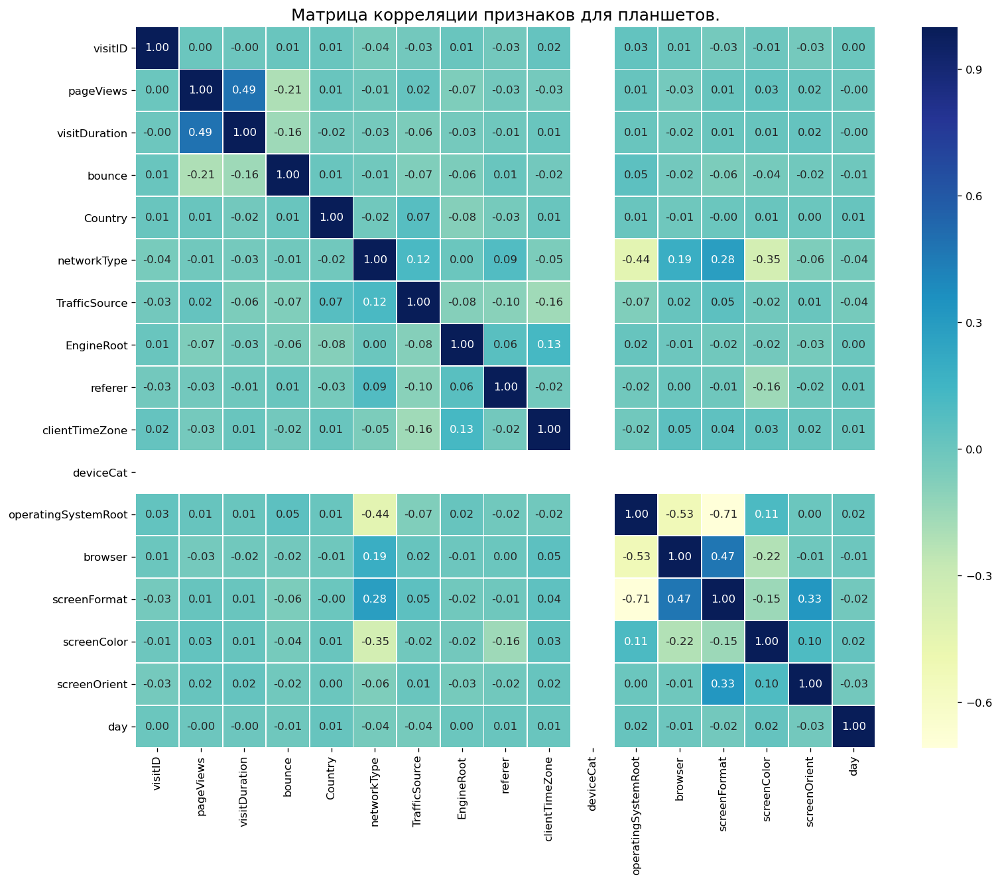

In [207]:
plt.figure(figsize=(15,12), dpi= 120)
plt.title('Матрица корреляции признаков для планшетов.', fontsize=15) 
m1 = mobcomp.corr()
ax = sns.heatmap(m1, annot=True, fmt='.2f', linewidths=.5, linecolor='white', cmap='YlGnBu')

Посмотрим на корреляции признаков среди визитов с планшета:

* Категория день недели не имеет сильных корреляций с другими признаками.
* отток перестает коррелировать с временными зонами (в общих данных было -0,32), с глубиной просмотра (-0,21), со временем на сайте (-0,16).
* источник трафика имеет малую корреляцию с типом соединения (0,12).
* страны практически не имеют корреляций.
* появилась корреляция типа соединения с ОС (-0,44) и браузером (0,19).
* появилась корреляция ОС с браузером (-0,53), так же ОС сильно (-0,71) коррелирует с соотношением сторон экрана планшета.

Отличия в корреляциях у 3-х типов устройств:
* у планшетов и ПК присутствует сильная корреляция ОС с соотношением сторон экрана и браузером.
* у планшетов и телефонов нет корреляции с временнЫми зонами.
* у телефонов корреляция типа соединения с ОС (-0,35).
* у ПК нет корреляций у источника трафика.

## 8. Проверка гипотез. <a id='100108'></a>

In [208]:
AD1['deviceCat'].value_counts()

1    39854
2    17925
3     5135
4       23
Name: deviceCat, dtype: int64

In [209]:
AD1.groupby('clientID')['visitID'].count()

clientID
0                       25449
154144070557623             1
154403455659752             1
1464535037345635            1
1465987021124147            2
                        ...  
15814503921070071729        1
15814568971063317863        1
15815649451016252274        1
15815856921071797192        1
15815977191032987756        1
Name: visitID, Length: 28873, dtype: int64

In [210]:
AD_d1 = AD1.query('deviceCat == 1')
AD_d2 = AD1.query('deviceCat == 2')  
AD_d3 = AD1.query('deviceCat == 3')                   
bou_1_ad = AD_d1.query('bounce == 1')
bou_2_ad = AD_d2.query('bounce == 1')                  
bou_3_ad = AD_d3.query('bounce == 1')                  

print('% отказов по устройствам среди рекламных визитов:')
print('ПК: {:.1f}'.format(len(bou_1_ad)/len(AD_d1)*100))
print('Телефоны: {:.1f}'.format(len(bou_2_ad)/len(AD_d2)*100))
print('Планшеты: {:.1f}'.format(len(bou_3_ad)/len(AD_d3)*100))

OTH_d1 = OTH1.query('deviceCat == 1')
OTH_d2 = OTH1.query('deviceCat == 2')  
OTH_d3 = OTH1.query('deviceCat == 3')                   
bou_1_oth = OTH_d1.query('bounce == 1')
bou_2_oth = OTH_d2.query('bounce == 1')                  
bou_3_oth = OTH_d3.query('bounce == 1')                  

print('% отказов по устройствам среди нерекламных визитов:')
print('ПК: {:.1f}'.format(len(bou_1_oth)/len(OTH_d1)*100))
print('Телефоны: {:.1f}'.format(len(bou_2_oth)/len(OTH_d2)*100))
print('Планшеты: {:.1f}'.format(len(bou_3_oth)/len(OTH_d3)*100))


% отказов по устройствам среди рекламных визитов:
ПК: 21.6
Телефоны: 21.2
Планшеты: 15.8
% отказов по устройствам среди нерекламных визитов:
ПК: 27.9
Телефоны: 24.8
Планшеты: 21.3


### 8.1. Гипотеза. Отказы на разных устройствах. <a id='108100'></a>
******************
Из данных можно сказать, что отказов с планшетов меньше и по рекламе и нет. Самое большое количество отказов в нерекламных визитах с ПК.
* **Выдвинем нулевую гипотезу, что отказы в зависимости от устройства не отличаются.**

In [211]:
sg1r1 = AD_d1['bounce']
sg1r2 = AD_d2['bounce']
sg1r3 = AD_d3['bounce']
sg1n1 = OTH_d1['bounce']
sg1n2 = OTH_d2['bounce']
sg1n3 = OTH_d3['bounce']
alpha = .05 # критический уровень статистической значимости

results_r1 = st.ttest_ind(
    sg1r1, 
    sg1r2)

results_r2 = st.ttest_ind(
    sg1r1, 
    sg1r3)

results_rn1 = st.ttest_ind(
    sg1r1, 
    sg1n1)

results_rn2 = st.ttest_ind(
    sg1r1, 
    sg1n2)

results_rn3 = st.ttest_ind(
    sg1r1, 
    sg1n3)
#1

results_r3 = st.ttest_ind(
    sg1r2, 
    sg1r3)

results_rn4 = st.ttest_ind(
    sg1r2, 
    sg1n1)

results_rn5 = st.ttest_ind(
    sg1r2, 
    sg1n2)

results_rn6 = st.ttest_ind(
    sg1r2, 
    sg1n3)
#2

results_rn7 = st.ttest_ind(
    sg1r3, 
    sg1n1)

results_rn8 = st.ttest_ind(
    sg1r3, 
    sg1n2)

results_rn9 = st.ttest_ind(
    sg1r3, 
    sg1n3)

#3
results_n1 = st.ttest_ind(
    sg1n1, 
    sg1n2)

results_n2 = st.ttest_ind(
    sg1n1, 
    sg1n3)

#4
results_n3 = st.ttest_ind(
    sg1n2, 
    sg1n3)

bonferroni_alpha = alpha / 15
#1
print('p-значение для сравнения отказов среди ПК и телефонов в рекламных визитах: ', results_r1.pvalue)
if (results_r1.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов в рекламных визитах")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов в рекламных визитах")
    
print('p-значение для сравнения отказов среди ПК и планшетов в рекламных визитах: ', results_r2.pvalue)    
if (results_r2.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов в рекламных визитах")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов в рекламных визитах")
    
print('p-значение для сравнения групп отказов среди планшетов и телефонов: ', results_r3.pvalue)    
if (results_r3.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов в рекламных визитах")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов в рекламных визитах")
#2
print('p-значение для сравнения отказов среди ПК рекламных и ПК нерекламных визитов: ', results_rn1.pvalue)
if (results_rn1.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и ПК нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и ПК нерекламных визитов")
    
print('p-значение для сравнения отказов среди ПК рекламных и телефонов нерекламных визитов: ', results_rn2.pvalue)    
if (results_rn2.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и телефонов нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и телефонов нерекламных визитов")
    
print('p-значение для сравнения групп отказов среди ПК рекламных и планшетов нерекламных визитов: ', results_rn3.pvalue)    
if (results_rn3.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и планшетов нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и планшетов нерекламных визитов")
    
print('p-значение для сравнения отказов среди телефонов рекламных и ПК нерекламных визитов: ', results_rn4.pvalue)
if (results_rn4.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди телефонов рекламных и ПК нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди телефонов рекламных и ПК нерекламных визитов")
    
print('p-значение для сравнения отказов среди телефонов рекламных и нерекламных визитов: ', results_rn5.pvalue)    
if (results_rn5.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди телефонов рекламных и нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди телефонов рекламных и нерекламных визитов")
    
print('p-значение для сравнения групп отказов среди телефонов рекламных и планшетов нерекламных визитов: ', results_rn6.pvalue)    
if (results_rn6.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди телефонов рекламных и планшетов нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди телефонов рекламных и планшетов нерекламных визитов")
    
print('p-значение для сравнения отказов среди планшетов рекламных и ПК нерекламных визитов: ', results_rn7.pvalue)
if (results_rn7.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов рекламных и ПК нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди планшетов рекламных и ПК нерекламных визитов")
    
print('p-значение для сравнения отказов среди планшетов рекламных и телефонов нерекламных визитов: ', results_rn8.pvalue)    
if (results_rn8.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов рекламных и телефонов нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди планшетов рекламных и телефонов нерекламных визитов")
    
print('p-значение для сравнения групп отказов среди планшетов рекламных и нерекламных визитов: ', results_rn9.pvalue)    
if (results_rn9.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов рекламных и нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди планшетов рекламных и нерекламных визитов")
#3
print('p-значение для сравнения отказов среди ПК и телефонов нерекламных визитов: ', results_n1.pvalue)
if (results_n1.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов нерекламных визитов")
    
print('p-значение для сравнения отказов среди ПК и планшетов нерекламных визитов: ', results_n2.pvalue)    
if (results_n2.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов нерекламных визитов")
    
print('p-значение для сравнения групп отказов среди планшетов и телефонов нерекламных визитов: ', results_n3.pvalue)    
if (results_n3.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов нерекламных визитов")

p-значение для сравнения отказов среди ПК и телефонов в рекламных визитах:  0.2575086778989988
Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов в рекламных визитах
p-значение для сравнения отказов среди ПК и планшетов в рекламных визитах:  5.364151282824496e-22
Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов в рекламных визитах
p-значение для сравнения групп отказов среди планшетов и телефонов:  1.4618973817525148e-17
Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов в рекламных визитах
p-значение для сравнения отказов среди ПК рекламных и ПК нерекламных визитов:  2.6244800559325835e-92
Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и ПК нерекламных визитов
p-значение для сравнения отказов среди ПК рекламных и телефонов нерекламных визитов:  4.2647477108740983e-13
Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК рекламных и теле

Во всех категориях есть статистически значимые различия, кроме:
* рекламных визитов с ПК и рекламных визитов с телефонов,
* рекламных визитов с ПК и нерекламных визитов с планшета,
* рекламных визитов с телефона и нерекламных визитов с планшета.

## или сделать проверку таких гипотез??

In [212]:
g_ya = desktop['bounce']
g_ri = phone['bounce']
g_ro = mobcomp['bounce']
alpha = .05 # критический уровень статистической значимости

results_ya_ri_1 = st.ttest_ind(
    g_ya, 
    g_ri)

results_ya_ro_1 = st.ttest_ind(
    g_ya, 
    g_ro)

results_ro_ri_1 = st.ttest_ind(
    g_ro, 
    g_ri)

bonferroni_alpha = alpha / 3

print('p-значение для сравнения отказов среди ПК и телефонов: ', results_ya_ri_1.pvalue)
if (results_ya_ri_1.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов")
    
print('p-значение для сравнения отказов среди ПК и планшетов: ', results_ya_ro_1.pvalue)    
if (results_ya_ro_1.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов")
    
print('p-значение для сравнения групп отказов среди планшетов и телефонов: ', results_ro_ri_1.pvalue)    
if (results_ro_ri_1.pvalue < bonferroni_alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов")

p-значение для сравнения отказов среди ПК и телефонов:  4.701781694947244e-13
Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и телефонов
p-значение для сравнения отказов среди ПК и планшетов:  1.3445763652560451e-43
Отвергаем нулевую гипотезу для сравнения групп по отказам среди ПК и планшетов
p-значение для сравнения групп отказов среди планшетов и телефонов:  1.0859346870801148e-19
Отвергаем нулевую гипотезу для сравнения групп по отказам среди планшетов и телефонов


Отказы зависят от используемого пользователем устройства.

### 8.2. Вторая гипотеза. Отказы в зависимости от рекламы. <a id='108101'></a>
******************
Из данных можно сделать вывод, что вроде бы отток, в зависимости от используемого пользователем устройства, не отличается.
* **Выдвинем нулевую гипотезу, что отказы в зависимости от того визиты рекламные или нет, не отличаются.**

In [213]:
g1 = AD1['bounce']
g2 = OTH1['bounce']

alpha = .05 # критический уровень статистической значимости

results_1 = st.ttest_ind(
    g1, 
    g2)

print('p-значение для сравнения отказов среди ПК и телефонов: ', results_1.pvalue)
if (results_1.pvalue < alpha):
    print("Отвергаем нулевую гипотезу для сравнения групп по отказам среди рекламных и нерекламных визитов")
else:
    print("Не получилось отвергнуть нулевую гипотезу для сравнения групп по отказам среди рекламных и нерекламных визитов")

p-значение для сравнения отказов среди ПК и телефонов:  6.279601903159844e-118
Отвергаем нулевую гипотезу для сравнения групп по отказам среди рекламных и нерекламных визитов


Отказы зависят от того рекламные это визиты или нет.

## 9. Выводы и базовые рекомендации. <a id='100109'></a>